# American Express - Прогнозирование дефолта клиента в будущем

American Express является глобально интегрированной платежной компанией. Крупнейший эмитент платежных карт в мире, они предоставляют клиентам доступ к продуктам, идеям и опыту, которые обогащают жизнь и способствуют успеху в бизнесе.

В этом соревновании применены навыки машинного обучения, чтобы предсказать кредитный дефолт. В частности, использован набор данных промышленного масштаба для создания модели машинного обучения, которая бросает вызов текущей модели в рабочей среде. Наборы данных для обучения, проверки и тестирования включают поведенческие данные временных рядов и анонимную информацию профиля клиента.

ссылка на соревнование: https://www.kaggle.com/competitions/amex-default-prediction/overview

В данном ноутбуке будет рассмотрена задача классификации: прогнозирование (predict) того, что клиент не вернет сумму баланса своей кредитной карты в будущем на основе своего ежемесячного профиля клиента.

Целевая двоичная переменная рассчитывается путем наблюдения за 18-месячным окном производительности после последней выписки по кредитной карте, и если клиент не платит причитающуюся сумму в течение 120 дней после своей последней даты выписки, это считается событием по умолчанию.

<a class='menu' id='menu'>

* [Загрузка данных](#loading)
* [1. EDA](#EDA)
* [2. Обработка выбросов](#blowout)
* [3. Обработка пропусков](#pass)
* [4. Построение новых признаков](#new_feature)
* [5. Построение графиков](#plot)
* [6. Отбор признаков](#selection)
* [7. Разбиение на train и test](#splitting)
* [8. Построение модели](#model)
* [9. Обучение моделей классификации](#lern)
* [10. Отбор лучшей модели. Выводы](#best)
* [11. Подбор гиперпараметров](#best_2)
* [12. Бизнес метрики](#busines)
* [13. Прогнозирование на тестовом датасете](#test)

#### Подключение библиотек и скриптов

In [1]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression 
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline, make_pipeline, FeatureUnion
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score
import seaborn as sns
from pylab import rcParams

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.style.use('fivethirtyeight')
matplotlib.rcParams.update({'font.size': 5})

import warnings
warnings.filterwarnings('ignore')

In [2]:
TRAIN_DATASET_PATH = 'E:/Загрузки/amex-default-prediction/train_data.csv'
TRAIN_LABELS_PATH = 'E:/Загрузки/amex-default-prediction/train_labels.csv'
TEST_DATASET_PATH = 'E:/Загрузки/amex-default-prediction/test_data.csv'
PREPARED_TRAIN_DATASET_PATH = 'E:/Загрузки/amex-default-prediction/samples_1.csv'

### Загрузка данных<a class='loading' id='loading'>

* [вернуться в меню](#menu)

#### Описание датасета.
Набор данных содержит агрегированные функции профиля для каждого клиента на дату каждой выписки. Функции анонимизируются и нормализуются и подразделяются на следующие общие категории:

D_* = Переменные просрочки\
S_* = Переменные расходов\
P_* = Платежные переменные\
B_* = Переменные баланса\
R_* = Переменные риска

Признаки, являющиеся категоричными:

['B_30', 'B_38', 'D_114', 'D_116', 'D_117', 'D_120', 'D_126', 'D_63', 'D_64', 'D_66', 'D_68']


Файлы:\
train_data.csv - обучающие данные с несколькими датами по customer_ID\
train_labels.csv - этикетка для каждого targetcustomer_ID\
test_data.csv - соответствующие тестовые данные\
sample_submission.csv - образец файла отправки в правильном формате

In [3]:
df=pd.read_csv(TRAIN_DATASET_PATH, sep=',')
df.head(5)

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,...,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145
0,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-03-09,0.938469,0.001733,0.008724,1.006838,0.009228,0.124035,0.008771,0.004709,...,NaN,NaN,NaN,0.002427,0.003706,0.003818,NaN,0.000569,0.000610,0.002674
1,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-04-07,0.936665,0.005775,0.004923,1.000653,0.006151,0.126750,0.000798,0.002714,...,NaN,NaN,NaN,0.003954,0.003167,0.005032,NaN,0.009576,0.005492,0.009217
2,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-05-28,0.954180,0.091505,0.021655,1.009672,0.006815,0.123977,0.007598,0.009423,...,NaN,NaN,NaN,0.003269,0.007329,0.000427,NaN,0.003429,0.006986,0.002603
3,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-06-13,0.960384,0.002455,0.013683,1.002700,0.001373,0.117169,0.000685,0.005531,...,NaN,NaN,NaN,0.006117,0.004516,0.003200,NaN,0.008419,0.006527,0.009600
4,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-07-16,0.947248,0.002483,0.015193,1.000727,0.007605,0.117325,0.004653,0.009312,...,NaN,NaN,NaN,0.003671,0.004946,0.008889,NaN,0.001670,0.008126,0.009827


In [4]:
df.shape

(5531451, 190)

*Набор данных содержит 5 531 451 строк, но таргет в банковской сфере проявляется в последних датах по каждому клиенту. Поэтому удалю дубликаты, оставив данные по последним выданным кредитам.*

In [4]:
df.drop_duplicates(subset=['customer_ID'], keep='last', inplace=True)
df.shape

(458913, 190)

### EDA<a class='EDA' id=EDA>
    
    Делаем EDA для:

- Исправления выбросов
- Заполнения NaN
- Идей для генерации новых фич

* [вернуться в меню](#menu)

<h5>смотрим основные ститистики</h5>

In [9]:
df.describe()

,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,...,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,target
count,455944.000000,4.589130e+05,458913.000000,4.588820e+05,4.589130e+05,373943.000000,4.588820e+05,4.588820e+05,59910.000000,324591.000000,...,1.639500e+04,1.639500e+04,4.560830e+05,4.589130e+05,4.560830e+05,80315.000000,4.560830e+05,4.589130e+05,4.560830e+05,458913.000000
mean,0.635249,2.014895e-01,0.139027,5.916128e-01,1.073958e-01,0.229064,9.948801e-02,1.548291e-01,0.177988,0.163768,...,1.414993e-02,1.590173e-01,1.811025e-01,2.893126e-02,1.665783e-01,0.394761,1.809953e-01,5.201583e-02,6.379602e-02,0.258934
std,0.267547,4.021565e-01,0.231266,4.121456e-01,2.786386e-01,0.198845,3.040705e-01,2.550615e-01,0.253631,0.227059,...,9.529647e-02,2.610814e-01,3.809093e-01,1.528808e-01,3.501717e-01,0.241254,3.808317e-01,1.820323e-01,1.970930e-01,0.438050
min,-0.458955,7.406592e-08,-3.571172,2.024839e-07,5.646122e-08,-0.508883,3.998730e-08,7.574315e-08,-0.000240,0.000002,...,3.704722e-07,1.703873e-07,2.207831e-08,7.897955e-09,9.490087e-08,-0.011438,1.653580e-08,1.995319e-08,2.811854e-09,0.000000
25%,0.449332,4.782223e-03,0.008984,7.091162e-02,2.957326e-03,0.127512,3.008724e-03,5.483745e-03,0.031770,0.043333,...,2.518881e-03,3.482435e-03,3.045516e-03,2.551175e-03,3.027869e-03,0.200727,3.032092e-03,2.757897e-03,3.031604e-03,0.000000
50%,0.682559,9.559730e-03,0.033219,8.134054e-01,5.920879e-03,0.164910,6.010615e-03,1.082996e-02,0.108293,0.092436,...,5.052533e-03,7.028427e-03,6.078699e-03,5.120597e-03,6.050620e-03,0.386107,6.065281e-03,5.501409e-03,6.072661e-03,0.000000
75%,0.862186,2.665587e-01,0.153634,1.001955e+00,8.891468e-03,0.264784,8.998209e-03,2.106605e-01,0.230394,0.195026,...,7.578314e-03,5.013750e-01,9.101306e-03,7.674505e-03,9.101263e-03,0.573958,9.097647e-03,8.251762e-03,9.101820e-03,1.000000
max,1.009998,5.001550e+00,1.324059,1.010000e+00,2.759738e+00,3.993525,8.988807e+00,1.596532e+00,4.186138,9.185313,...,1.009950e+00,2.505057e+00,1.010000e+00,1.010000e+00,1.339910e+00,2.229182,1.010000e+00,1.343326e+00,4.827630e+00,1.000000


*выявлены пустые значения, выбрасов не обнаружено*

In [10]:
df.dtypes.value_counts()

float64    185
object       4
int64        2
dtype: int64

*всего 185 колонок с плавающими значениями, 4 из них строковые и 2 признака содержат значения типа int*

In [11]:
df.select_dtypes(include = ['object', 'int64'])

,customer_ID,S_2,D_63,D_64,B_31,target
0,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2018-03-13,CR,O,1,0
1,00000fd6641609c6ece5454664794f0340ad84dddce9a2...,2018-03-25,CO,O,1,0
2,00001b22f846c82c51f6e3958ccd81970162bae8b007e8...,2018-03-12,CO,R,1,0
3,000041bdba6ecadd89a52d11886e8eaaec9325906c9723...,2018-03-29,CO,O,1,0
4,00007889e4fcd2614b6cbe7f8f3d2e5c728eca32d9eb8a...,2018-03-30,CO,O,1,0
...,...,...,...,...,...,...
458908,ffff41c8a52833b56430603969b9ca48d208e7c192c6a4...,2018-03-31,CO,U,1,0
458909,ffff518bb2075e4816ee3fe9f3b152c57fc0e6f01bf7fd...,2018-03-22,CO,R,1,0
458910,ffff9984b999fccb2b6127635ed0736dda94e544e67e02...,2018-03-07,CO,U,1,0
458911,ffffa5c46bc8de74f5a4554e74e239c8dee6b9baf38814...,2018-03-23,CO,U,1,1


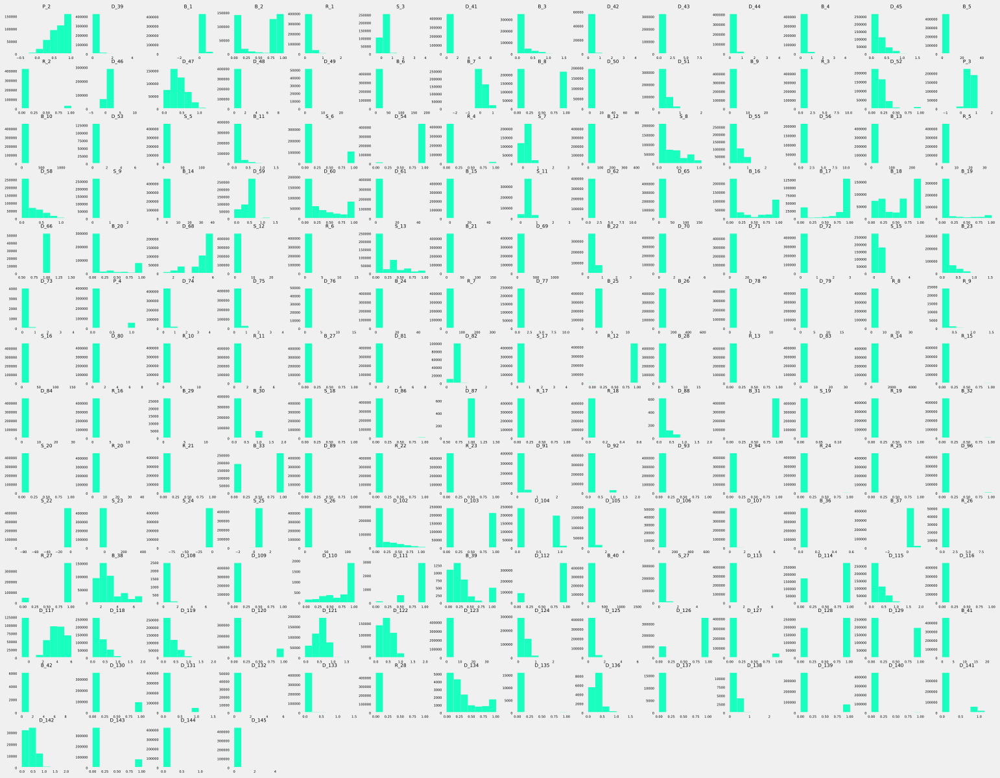

In [5]:
df.hist(figsize=(24,20), bins=7, grid=False, color='#18FFC0');

*Разнонаправленные данные. Много признаков с пустыми значениями. Проверить на выбросы признаки D_41, D_43, B_5, R_3, B_9, D_50, B_12, B_13, R_5*

### 2. Обработка выбросов<a class='blowout' id='blowout'>

* [вернуться в меню](#menu)

*Для каждого признака, если value_counts повторяется, выведем эти значения, чтобы определить категорийность и выбросы*

In [6]:
i = 0
while i < 190:
    col = df[df.columns[i]].value_counts()
    if col.iloc[0] > 1:
        print(col)
    else: 
        print(f'---в {i} столбце {df.columns[i]} нет повторений  -----')
    i+=1

---в 0 столбце customer_ID нет повторений  -----
2018-03-17    23373
2018-03-03    22887
2018-03-10    21547
2018-03-24    21156
2018-03-20    18567
2018-03-30    17293
2018-03-28    17263
2018-03-15    16733
2018-03-21    16478
2018-03-16    16395
2018-03-19    16385
2018-03-23    16325
2018-03-26    15940
2018-03-12    15916
2018-03-13    15737
2018-03-09    15737
2018-03-08    15581
2018-03-27    15457
2018-03-14    15172
2018-03-29    14414
2018-03-22    14146
2018-03-01    12128
2018-03-02    10562
2018-03-05    10081
2018-03-31     9836
2018-03-06     9736
2018-03-07     9097
2018-03-04     8918
2018-03-25     8856
2018-03-11     8643
2018-03-18     8554
Name: S_2, dtype: int64
---в 2 столбце P_2 нет повторений  -----
---в 3 столбце D_39 нет повторений  -----
---в 4 столбце B_1 нет повторений  -----
---в 5 столбце B_2 нет повторений  -----
---в 6 столбце R_1 нет повторений  -----
---в 7 столбце S_3 нет повторений  -----
---в 8 столбце D_41 нет повторений  -----
---в 9 столбце B_3

---в 169 столбце D_128 нет повторений  -----
---в 170 столбце D_129 нет повторений  -----
---в 171 столбце B_41 нет повторений  -----
---в 172 столбце B_42 нет повторений  -----
---в 173 столбце D_130 нет повторений  -----
---в 174 столбце D_131 нет повторений  -----
---в 175 столбце D_132 нет повторений  -----
---в 176 столбце D_133 нет повторений  -----
---в 177 столбце R_28 нет повторений  -----
---в 178 столбце D_134 нет повторений  -----
---в 179 столбце D_135 нет повторений  -----
---в 180 столбце D_136 нет повторений  -----
---в 181 столбце D_137 нет повторений  -----
---в 182 столбце D_138 нет повторений  -----
---в 183 столбце D_139 нет повторений  -----
---в 184 столбце D_140 нет повторений  -----
---в 185 столбце D_141 нет повторений  -----
---в 186 столбце D_142 нет повторений  -----
---в 187 столбце D_143 нет повторений  -----
---в 188 столбце D_144 нет повторений  -----
---в 189 столбце D_145 нет повторений  -----


IndexError: index 190 is out of bounds for axis 0 with size 190

- Данные в датафрейме приведены за март 2018
- значения в D_63 категорийные и снижаются достаточно плавно, выбрасов не обнаружено.
- значения в D_64 категорийные и снижаются достаточно плавно, выбрасов не обнаружено.
- признак D_66, D_87 имеет только значения 1, остальные пустые, в дальнейшем заполним 0.

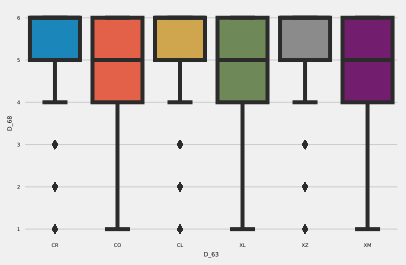

In [6]:
col = df['D_63']
n = df['D_68']
sns.boxplot(x=col, y=n, whis=1.5)

plt.xlabel('D_63')
plt.show()

В целом больших расхождений в числовых признаках не наблюдается

### 3. Обработка пропусков<a class='pass' id='pass'>

* [вернуться в меню](#menu)

-<i> Проверим есть ли пустые значения в датафрейме. заменим такие значения.

In [14]:
df[df.columns[180:191]].isna().sum()

D_136     442518
D_137     442518
D_138     442518
D_139       2830
D_140          0
D_141       2830
D_142     378598
D_143       2830
D_144          0
D_145       2830
target         0
dtype: int64

Посмотрим на основные статистики признаков, имеющих пустые значения. Заполним пустные значения на 0.

In [7]:
%%time
for i in range(0, 191):

    try:
        df.loc[df[df.columns[i]].isna(), df.columns[i]] = 0
        print(f'----- колонка {i}- {df.columns[i]}-------')
    except TypeError:
        print(f'----- колонка {i} {df.columns[i]} строковые значения ----')

----- колонка 0- customer_ID-------
----- колонка 1- S_2-------
----- колонка 2- P_2-------
----- колонка 3- D_39-------
----- колонка 4- B_1-------
----- колонка 5- B_2-------
----- колонка 6- R_1-------
----- колонка 7- S_3-------
----- колонка 8- D_41-------
----- колонка 9- B_3-------
----- колонка 10- D_42-------
----- колонка 11- D_43-------
----- колонка 12- D_44-------
----- колонка 13- B_4-------
----- колонка 14- D_45-------
----- колонка 15- B_5-------
----- колонка 16- R_2-------
----- колонка 17- D_46-------
----- колонка 18- D_47-------
----- колонка 19- D_48-------
----- колонка 20- D_49-------
----- колонка 21- B_6-------
----- колонка 22- B_7-------
----- колонка 23- B_8-------
----- колонка 24- D_50-------
----- колонка 25- D_51-------
----- колонка 26- B_9-------
----- колонка 27- R_3-------
----- колонка 28- D_52-------
----- колонка 29- P_3-------
----- колонка 30- B_10-------
----- колонка 31- D_53-------
----- колонка 32- S_5-------
----- колонка 33- B_11-------


IndexError: index 190 is out of bounds for axis 0 with size 190

In [8]:
df.shape

(458913, 190)

In [17]:
df[df.columns[54]].value_counts()

O    244622
U    132722
R     71532
0     10037
Name: D_64, dtype: int64

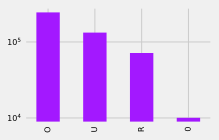

In [8]:
rcParams['figure.figsize'] = 3, 2
matplotlib.rcParams.update({'font.size': 8})
df[df.columns[54]].value_counts().plot(kind="bar", logy=True, color='#A318FF')

plt.show()

In [9]:
class DataPreprocessing:
    """Подготовка исходных данных"""

    def __init__(self):
        """Параметры класса"""

        
    def fit(self, X):
        """Сохранение статистик"""       

        
    def transform(self, X):
        """Трансформация данных"""

        X.loc[X['P_2'].isna(), 'P_2'] = 0
        X.loc[X['S_3'].isna(), 'S_3'] = 0
        X.loc[X['D_64'].isna(), 'D_64'] = 0
        X.loc[X['D_41'].isna(), 'D_41'] = 0
        X.loc[X['B_3'].isna(), 'B_3'] = 0
        X.loc[X['D_42'].isna(), 'D_42'] = 0
        X.loc[X['D_43'].isna(), 'D_43'] = 0
        X.loc[X['D_44'].isna(), 'D_44'] = 0
        X.loc[X['D_45'].isna(), 'D_45'] = 0
        X.loc[X['D_46'].isna(), 'D_46'] = 0
        X.loc[X['D_48'].isna(), 'D_48'] = 0
        X.loc[X['D_49'].isna(), 'D_49'] = 0
        X.loc[X['B_6'].isna(), 'B_6'] = 0
        X.loc[X['B_8'].isna(), 'B_8'] = 0
        X.loc[X['D_50'].isna(), 'D_50'] = 0
        X.loc[X['D_52'].isna(), 'D_52'] = 0
        X.loc[X['P_3'].isna(), 'P_3'] = 0
        X.loc[X['D_53'].isna(), 'D_53'] = 0
        X.loc[X['D_54'].isna(), 'D_54'] = 0
        X.loc[X['S_7'].isna(), 'S_7'] = 0
        X.loc[X['D_55'].isna(), 'D_55'] = 0
        X.loc[X['D_56'].isna(), 'D_56'] = 0
        X.loc[X['B_13'].isna(), 'B_13'] = 0
        X.loc[X['S_9'].isna(), 'S_9'] = 0
        X.loc[X['D_59'].isna(), 'D_59'] = 0
        X.loc[X['D_61'].isna(), 'D_61'] = 0
        X.loc[X['B_15'].isna(), 'B_15'] = 0
        X.loc[X['D_62'].isna(), 'D_62'] = 0
        X.loc[X['B_16'].isna(), 'B_16'] = 0
        X.loc[X['B_17'].isna(), 'B_17'] = 0
        X.loc[X['B_19'].isna(), 'B_19'] = 0
        X.loc[X['D_66'].isna(), 'D_66'] = 0
        X.loc[X['B_20'].isna(), 'B_20'] = 0
        X.loc[X['D_68'].isna(), 'D_68'] = 0
        X.loc[X['S_12'].isna(), 'S_12'] = 0
        X.loc[X['D_69'].isna(), 'D_69'] = 0
        X.loc[X['B_22'].isna(), 'B_22'] = 0
        X.loc[X['D_70'].isna(), 'D_70'] = 0
        X.loc[X['D_72'].isna(), 'D_72'] = 0
        X.loc[X['D_73'].isna(), 'D_73'] = 0
        X.loc[X['D_74'].isna(), 'D_74'] = 0
        X.loc[X['D_76'].isna(), 'D_76'] = 0
        X.loc[X['D_77'].isna(), 'D_77'] = 0
        X.loc[X['B_25'].isna(), 'B_25'] = 0
        X.loc[X['B_26'].isna(), 'B_26'] = 0
        X.loc[X['D_78'].isna(), 'D_78'] = 0
        X.loc[X['D_79'].isna(), 'D_79'] = 0
        X.loc[X['R_9'].isna(), 'R_9'] = 0
        X.loc[X['D_80'].isna(), 'D_80'] = 0
        X.loc[X['B_27'].isna(), 'B_27'] = 0
        X.loc[X['D_81'].isna(), 'D_81'] = 0
        X.loc[X['D_82'].isna(), 'D_82'] = 0
        X.loc[X['S_17'].isna(), 'S_17'] = 0
        X.loc[X['D_83'].isna(), 'D_83'] = 0
        X.loc[X['D_84'].isna(), 'D_84'] = 0
        X.loc[X['B_29'].isna(), 'B_29'] = 0
        X.loc[X['B_30'].isna(), 'B_30'] = 0
        X.loc[X['D_86'].isna(), 'D_86'] = 0
        X.loc[X['D_87'].isna(), 'D_87'] = 0
        X.loc[X['D_88'].isna(), 'D_88'] = 0
        X.loc[X['B_33'].isna(), 'B_33'] = 0
        X.loc[X['D_89'].isna(), 'D_89'] = 0
        X.loc[X['D_91'].isna(), 'D_91'] = 0
        X.loc[X['S_22'].isna(), 'S_22'] = 0
        X.loc[X['S_23'].isna(), 'S_23'] = 0
        X.loc[X['S_24'].isna(), 'S_24'] = 0
        X.loc[X['S_25'].isna(), 'S_25'] = 0
        X.loc[X['S_26'].isna(), 'S_26'] = 0
        X.loc[X['D_102'].isna(), 'D_102'] = 0
        X.loc[X['D_103'].isna(), 'D_103'] = 0
        X.loc[X['D_104'].isna(), 'D_104'] = 0
        X.loc[X['D_105'].isna(), 'D_105'] = 0
        X.loc[X['D_106'].isna(), 'D_106'] = 0
        X.loc[X['D_107'].isna(), 'D_107'] = 0
        X.loc[X['B_37'].isna(), 'B_37'] = 0
        X.loc[X['R_26'].isna(), 'R_26'] = 0
        X.loc[X['R_27'].isna(), 'R_27'] = 0
        X.loc[X['B_38'].isna(), 'B_38'] = 0
        X.loc[X['D_108'].isna(), 'D_108'] = 0
        X.loc[X['D_109'].isna(), 'D_109'] = 0
        X.loc[X['D_110'].isna(), 'D_110'] = 0
        X.loc[X['D_111'].isna(), 'D_111'] = 0
        X.loc[X['B_39'].isna(), 'B_39'] = 0
        X.loc[X['D_112'].isna(), 'D_112'] = 0
        X.loc[X['B_40'].isna(), 'B_40'] = 0
        X.loc[X['S_27'].isna(), 'S_27'] = 0
        X.loc[X['D_113'].isna(), 'D_113'] = 0
        X.loc[X['D_114'].isna(), 'D_114'] = 0
        X.loc[X['D_115'].isna(), 'D_115'] = 0
        X.loc[X['D_116'].isna(), 'D_116'] = 0
        X.loc[X['D_117'].isna(), 'D_117'] = 0
        X.loc[X['D_118'].isna(), 'D_118'] = 0
        X.loc[X['D_119'].isna(), 'D_119'] = 0
        X.loc[X['D_120'].isna(), 'D_120'] = 0
        X.loc[X['D_121'].isna(), 'D_121'] = 0
        X.loc[X['D_122'].isna(), 'D_122'] = 0
        X.loc[X['D_123'].isna(), 'D_123'] = 0
        X.loc[X['D_124'].isna(), 'D_124'] = 0
        X.loc[X['D_125'].isna(), 'D_125'] = 0
        X.loc[X['D_126'].isna(), 'D_126'] = 0
        X.loc[X['D_128'].isna(), 'D_128'] = 0
        X.loc[X['D_129'].isna(), 'D_129'] = 0
        X.loc[X['B_41'].isna(), 'B_41'] = 0
        X.loc[X['B_42'].isna(), 'B_42'] = 0
        X.loc[X['D_130'].isna(), 'D_130'] = 0
        X.loc[X['D_131'].isna(), 'D_131'] = 0
        X.loc[X['D_132'].isna(), 'D_132'] = 0
        X.loc[X['D_133'].isna(), 'D_133'] = 0
        X.loc[X['D_134'].isna(), 'D_134'] = 0
        X.loc[X['D_135'].isna(), 'D_135'] = 0
        X.loc[X['D_136'].isna(), 'D_136'] = 0
        X.loc[X['D_137'].isna(), 'D_137'] = 0
        X.loc[X['D_138'].isna(), 'D_138'] = 0
        X.loc[X['D_139'].isna(), 'D_139'] = 0
        X.loc[X['D_140'].isna(), 'D_140'] = 0
        X.loc[X['D_141'].isna(), 'D_141'] = 0
        X.loc[X['D_142'].isna(), 'D_142'] = 0
        X.loc[X['D_143'].isna(), 'D_143'] = 0
        X.loc[X['D_144'].isna(), 'D_144'] = 0
        X.loc[X['D_145'].isna(), 'D_145'] = 0
       
        return X

### 4. Построение новых признаков<a class='new_feature' id='new_feature'>

* [вернуться в меню](#menu)

Переведем бинарные данные в категориальные

In [10]:
def binary_to_cat(X):
    X['D_64_cat'] = 0
    X.loc[X['D_64'] == 0, 'D_64_cat'] = 0
    X.loc[X['D_64'] == 'O', 'D_64_cat'] = 1
    X.loc[X['D_64'] == 'U', 'D_64_cat'] = 2
    X.loc[X['D_64'] == 'R', 'D_64_cat'] = 3
    X.loc[X['D_64'] == -1, 'D_64_cat'] = -1
    
    return X

def binary_to_cat_2(X):
    X['D_63_cat'] = 0
    
    X.loc[X['D_63'] == 'CO', 'D_63_cat'] = 0
    X.loc[X['D_63'] == 'CR', 'D_63_cat'] = 1
    X.loc[X['D_63'] == 'CL', 'D_63_cat'] = 2
    X.loc[X['D_63'] == 'XZ', 'D_63_cat'] = 3
    X.loc[X['D_63'] == 'XM', 'D_63_cat'] = 4
    X.loc[X['D_63'] == 'XL', 'D_63_cat'] = 5    
    
    return X

In [11]:
df = binary_to_cat(df)
df = binary_to_cat_2(df)

In [12]:
pd.set_option('display.max_columns', None)
df.head(3)

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,D_44,B_4,D_45,B_5,R_2,D_46,D_47,D_48,D_49,B_6,B_7,B_8,D_50,D_51,B_9,R_3,D_52,P_3,B_10,D_53,S_5,B_11,S_6,D_54,R_4,S_7,B_12,S_8,D_55,D_56,B_13,R_5,D_58,S_9,B_14,D_59,D_60,D_61,B_15,S_11,D_62,D_63,D_64,D_65,B_16,B_17,B_18,B_19,D_66,B_20,D_68,S_12,R_6,S_13,B_21,D_69,B_22,D_70,D_71,D_72,S_15,B_23,D_73,P_4,D_74,D_75,D_76,B_24,R_7,D_77,B_25,B_26,D_78,D_79,R_8,R_9,S_16,D_80,R_10,R_11,B_27,D_81,D_82,S_17,R_12,B_28,R_13,D_83,R_14,R_15,D_84,R_16,B_29,B_30,S_18,D_86,D_87,R_17,R_18,D_88,B_31,S_19,R_19,B_32,S_20,R_20,R_21,B_33,D_89,R_22,R_23,D_91,D_92,D_93,D_94,R_24,R_25,D_96,S_22,S_23,S_24,S_25,S_26,D_102,D_103,D_104,D_105,D_106,D_107,B_36,B_37,R_26,R_27,B_38,D_108,D_109,D_110,D_111,B_39,D_112,B_40,S_27,D_113,D_114,D_115,D_116,D_117,D_118,D_119,D_120,D_121,D_122,D_123,D_124,D_125,D_126,D_127,D_128,D_129,B_41,B_42,D_130,D_131,D_132,D_133,R_28,D_134,D_135,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,D_64_cat,D_63_cat
12,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2018-03-13,0.934745,0.009119,0.009382,1.007647,0.006104,0.135021,0.001604,0.007174,0.0,0.000000,0.003258,0.070793,0.740102,0.231717,0.008309,0.420521,0.539715,0.192376,0.0,0.149564,0.058425,0.002927,0.153461,0.673522,0.009535,0.000085,0.203524,0.629392,0.326101,0.0,0.034643,0.010260,0.001770,1.008097,0.008517,0.105671,0.112294,0.488232,0.187285,0.166636,0.100107,0.009444,0.007174,0.007397,0.010239,0.063465,0.258461,0.227637,0.014553,0.402246,0.446568,CR,O,0.008656,0.006408,0.0,1.007897,0.005274,0.0,0.007630,6.0,0.184036,0.003945,0.686719,0.005375,0.005469,0.008050,0.008254,0.377991,0.006970,0.304625,0.040367,0.0,0.006564,0.001298,0.001352,0.0,0.002230,0.009162,0.421334,0.006475,0.001068,0.000747,0.002193,0.006345,0.0,0.000026,0.208253,0.001057,0.009351,0.007236,0.009177,0.507423,0.006550,1.002178,0.084745,0.006099,0.000013,0.002902,0.001115,0.001911,0.003256,0.0,0.0,0.001277,0.009968,0.0,0.002330,0.002517,0.0,1,0.003511,0.008099,0.007645,0.009411,0.006355,0.008501,1.007528,0.004638,0.001445,0.003080,1.006011,0.003641,0.004638,0.003866,0.005909,0.005458,0.001190,0.917811,0.131801,0.936067,0.971994,0.001281,0.943340,1.002457,1.014510,1.073985,0.0,0.671683,0.007441,0.008676,0.0,1.006130,2.0,0.0,0.000226,0.0,0.0,0.0,1.009372,0.100454,0.928955,0.003658,1.0,0.255787,0.0,4.0,0.260255,0.256656,0.0,0.719791,0.433844,0.003580,0.684978,0.008398,1.0,1.008338,0.999737,1.008523,0.003973,0.0,0.004186,0.005702,0.0,0.006210,0.002715,0.0,0.0,0.0,0.0,0.0,0.007186,0.004234,0.005086,0.0,0.005810,0.002970,0.008533,1,1
25,00000fd6641609c6ece5454664794f0340ad84dddce9a2...,2018-03-25,0.880519,0.178126,0.034684,1.004028,0.006911,0.165509,0.005552,0.005068,0.0,0.060646,0.008781,0.020626,0.266275,0.027000,0.004976,0.438828,0.402195,0.014696,0.0,0.167634,0.028411,0.000974,0.000000,0.339683,0.012926,0.102036,0.242366,0.570898,0.297130,0.0,0.043929,0.014570,0.002911,1.002821,0.003283,0.208516,0.019050,0.406434,0.036112,0.748383,0.017684,0.005880,0.009756,0.127805,0.018667,0.212538,0.411989,0.048978,0.009538,0.363754,0.233980,CO,O,0.008747,0.002940,0.0,1.003602,0.008047,0.0,0.004319,6.0,0.192371,0.007744,0.287101,0.006190,0.007636,0.006174,0.000883,0.007636,0.001278,0.304711,0.014705,0.0,0.004659,0.007925,0.009600,0.0,0.002383,0.008256,0.227755,0.021153,0.000182,0.001542,0.009117,0.006892,0.0,0.006931,0.002119,0.002046,0.009664,0.005375,0.005009,0.000000,0.005414,1.008568,0.019672,0.006197,0.005370,0.006271,0.009911,0.000983,0.006669,0.0,0.0,0.009298,0.006460,0.0,0.006503,0.007052,0.0,1,0.005091,0.001838,0.008645,0.009467,0.003500,0.000473,1.000766,0.004864,0.000907,0.003830,0.009166,0.004641,0.000195,0.000523,0.006421,0.004975,0.002397,0.920889,0.132865,0.930629,0.977674,0.003213,0.001621,0.008952,0.004363,0.000000,0.0,0.007774,0.007457,0.032899,0.0,1.007599,2.0,0.0,0.004743,0.0,0.0,0.0,1.006547,0.019811,0.292214,0.009312,1.0,0.454329,0.0,-1.0,0.446036,0.436884,0.0,0.551341,0.286821,0.008603,0.136650,0.009314,1.0,0.000229,0.999252,0

предположим, что переменные просрочки зависят от переменных баланса и платежных переменных

In [13]:
def D_S_to_cat(X):
    X['D_S_cat'] = 0
    
    X.loc[(X['D_114'] == 0) & (df['S_11'] < df['S_11'].median()), 'D_S_cat'] = 1
    X.loc[(X['D_114'] == 0) & (df['S_11'] > df['S_11'].median()), 'D_S_cat'] = 2
    X.loc[(X['D_114'] == 1) & (df['S_11'] < df['S_11'].median()), 'D_S_cat'] = 3
    X.loc[(X['D_114'] == 1) & (df['S_11'] > df['S_11'].median()), 'D_S_cat'] = 4
    
    return X

def D_B_to_cat(X):
    X['D_B_cat'] = 0
    
    X.loc[(X['D_126'] == 0) & (df['B_4'] < df['B_4'].mean()), 'D_B_cat'] = 1
    X.loc[(X['D_126'] == 0) & (df['B_4'] > df['B_4'].mean()), 'D_B_cat'] = 2
    X.loc[(X['D_126'] == 1) & (df['B_4'] < df['B_4'].mean()), 'D_B_cat'] = 3
    X.loc[(X['D_126'] == 1) & (df['B_4'] > df['B_4'].mean()), 'D_B_cat'] = 4
    
    return X

def D_B_to_cat_2(X):
    X['D_B_cat_2'] = 0
    
    X.loc[(X['D_48'] <= df['D_48'].median()) & (df['B_7'] <= df['B_7'].mean()), 'D_B_cat_2'] = 1
    X.loc[(X['D_48'] <= df['D_48'].median()) & (df['B_7'] > df['B_7'].mean()), 'D_B_cat_2'] = 2
    X.loc[(X['D_48'] > df['D_48'].median()) & (X['D_48'] <= 1) & (df['B_7'] <= df['B_7'].mean()), 'D_B_cat_2'] = 3
    X.loc[(X['D_48'] > df['D_48'].median()) & (X['D_48'] <= 1) & (df['B_7'] > df['B_7'].mean()), 'D_B_cat_2'] = 4
    X.loc[(X['D_48'] > 1) & (df['B_7'] <= df['B_7'].mean()), 'D_B_cat_2'] = 5
    X.loc[(X['D_48'] > 1) & (df['B_7'] > df['B_7'].mean()), 'D_B_cat_2'] = 6

    return X

In [14]:
df = D_S_to_cat(df)
df = D_B_to_cat(df)
df = D_B_to_cat_2(df)
df.head(5)

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,D_44,B_4,D_45,B_5,R_2,D_46,D_47,D_48,D_49,B_6,B_7,B_8,D_50,D_51,B_9,R_3,D_52,P_3,B_10,D_53,S_5,B_11,S_6,D_54,R_4,S_7,B_12,S_8,D_55,D_56,B_13,R_5,D_58,S_9,B_14,D_59,D_60,D_61,B_15,S_11,D_62,D_63,D_64,D_65,B_16,B_17,B_18,B_19,D_66,B_20,D_68,S_12,R_6,S_13,B_21,D_69,B_22,D_70,D_71,D_72,S_15,B_23,D_73,P_4,D_74,D_75,D_76,B_24,R_7,D_77,B_25,B_26,D_78,D_79,R_8,R_9,S_16,D_80,R_10,R_11,B_27,D_81,D_82,S_17,R_12,B_28,R_13,D_83,R_14,R_15,D_84,R_16,B_29,B_30,S_18,D_86,D_87,R_17,R_18,D_88,B_31,S_19,R_19,B_32,S_20,R_20,R_21,B_33,D_89,R_22,R_23,D_91,D_92,D_93,D_94,R_24,R_25,D_96,S_22,S_23,S_24,S_25,S_26,D_102,D_103,D_104,D_105,D_106,D_107,B_36,B_37,R_26,R_27,B_38,D_108,D_109,D_110,D_111,B_39,D_112,B_40,S_27,D_113,D_114,D_115,D_116,D_117,D_118,D_119,D_120,D_121,D_122,D_123,D_124,D_125,D_126,D_127,D_128,D_129,B_41,B_42,D_130,D_131,D_132,D_133,R_28,D_134,D_135,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,D_64_cat,D_63_cat,D_S_cat,D_B_cat,D_B_cat_2
12,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2018-03-13,0.934745,0.009119,0.009382,1.007647,0.006104,0.135021,0.001604,0.007174,0.0,0.000000,0.003258,0.070793,0.740102,0.231717,0.008309,0.420521,0.539715,0.192376,0.0,0.149564,0.058425,0.002927,0.153461,0.673522,0.009535,0.000085,0.203524,0.629392,0.326101,0.000000,0.034643,0.010260,0.001770,1.008097,0.008517,0.105671,0.112294,0.488232,0.187285,0.166636,0.100107,0.009444,0.007174,0.007397,0.010239,0.063465,0.258461,0.227637,0.014553,0.402246,0.446568,CR,O,0.008656,0.006408,0.000000,1.007897,0.005274,0.0,0.007630,6.0,0.184036,0.003945,0.686719,0.005375,0.005469,0.008050,0.008254,0.377991,0.006970,0.304625,0.040367,0.0,0.006564,0.001298,0.001352,0.0,0.002230,0.009162,0.421334,0.006475,0.001068,0.000747,0.002193,0.006345,0.0,0.000026,0.208253,0.001057,0.009351,0.007236,0.009177,0.507423,0.006550,1.002178,0.084745,0.006099,0.000013,0.002902,0.001115,0.001911,0.003256,0.0,0.0,0.001277,0.009968,0.0,0.002330,0.002517,0.0,1,0.003511,0.008099,0.007645,0.009411,0.006355,0.008501,1.007528,0.004638,0.001445,0.003080,1.006011,0.003641,0.004638,0.003866,0.005909,0.005458,0.001190,0.917811,0.131801,0.936067,0.971994,0.001281,0.943340,1.002457,1.014510,1.073985,0.0,0.671683,0.007441,0.008676,0.0,1.006130,2.0,0.0,0.000226,0.0,0.0,0.0,1.009372,0.100454,0.928955,0.003658,1.0,0.255787,0.0,4.0,0.260255,0.256656,0.0,0.719791,0.433844,0.003580,0.684978,0.008398,1.0,1.008338,0.999737,1.008523,0.003973,0.0,0.004186,0.005702,0.0,0.006210,0.002715,0.0,0.0,0.0,0.0,0.0,0.007186,0.004234,0.005086,0.0,0.005810,0.002970,0.008533,1,1,4,3,1
25,00000fd6641609c6ece5454664794f0340ad84dddce9a2...,2018-03-25,0.880519,0.178126,0.034684,1.004028,0.006911,0.165509,0.005552,0.005068,0.0,0.060646,0.008781,0.020626,0.266275,0.027000,0.004976,0.438828,0.402195,0.014696,0.0,0.167634,0.028411,0.000974,0.000000,0.339683,0.012926,0.102036,0.242366,0.570898,0.297130,0.000000,0.043929,0.014570,0.002911,1.002821,0.003283,0.208516,0.019050,0.406434,0.036112,0.748383,0.017684,0.005880,0.009756,0.127805,0.018667,0.212538,0.411989,0.048978,0.009538,0.363754,0.233980,CO,O,0.008747,0.002940,0.000000,1.003602,0.008047,0.0,0.004319,6.0,0.192371,0.007744,0.287101,0.006190,0.007636,0.006174,0.000883,0.007636,0.001278,0.304711,0.014705,0.0,0.004659,0.007925,0.009600,0.0,0.002383,0.008256,0.227755,0.021153,0.000182,0.001542,0.009117,0.006892,0.0,0.006931,0.002119,0.002046,0.009664,0.005375,0.005009,0.000000,0.005414,1.008568,0.019672,0.006197,0.005370,0.006271,0.009911,0.000983,0.006669,0.0,0.0,0.009298,0.006460,0.0,0.006503,0.007052,0.0,1,0.005091,0.001838,0.008645,0.009467,0.003500,0.000473,1.000766,0.004864,0.000907,0.003830,0.009166,0.004641,0.000195,0.000523,0.006421,0.004975,0.002397,0.920889,0.132865,0.930629,0.977674,0.003213,0.001621,0.008952,0.004363,0.000000,0.0,0.007774,0.007457,0.032899,0.0,1.007599,2.0,0.0,0.004743,0.0,0.0,0.0,1.006547,0.019811,0.292214,0.009312,1.0,0.454329,0.0,-1.0,0.446036,0.436884,0.0,0.551341,0.28682

In [49]:
class FeatureGenetator():
    """Генерация новых фич"""
    
    def __init__(self):
        self.binary_to_numbers = None
        self.binary_to_cat = None
        
    def fit(self, X, y=None):
        
        X = X.copy()
        
        # Binary features
        self.binary_to_numbers = {0: 0, 'O': 1, 'U': 2, 'R': 3, -1: -1}
        X.loc[X['B_2'].isna(), 'B_2'] = 0
        self.binary_to_cat = {'CO':0, 'CR':1, 'CL':2, 'XZ':3, 'XM':4, 'XL':5}
        
        return X
    
    def transform(self, X):
        
        # Binary features
        X['D_64_cat'] = X['D_64'].map(self.binary_to_numbers)  # self.binary_to_numbers={0:0, 'O':1, 'U':2, 'R':3, -1:-1}
        X['D_63_cat'] = X['D_63'].map(self.binary_to_cat)
        
        # More categorical features
        X = self.D_S_to_cat(X) 
        X = self.D_B_to_cat(X) 
        X = self.D_B_to_cat_2(X)
        
        return X
     
    
    def D_S_to_cat(self, X):
        X['D_S_cat'] = 0
        X.loc[(X['D_114'] == 0) & (X['S_11'] < X['S_11'].median()), 'D_S_cat'] = 1
        X.loc[(X['D_114'] == 0) & (X['S_11'] > X['S_11'].median()), 'D_S_cat'] = 2
        X.loc[(X['D_114'] == 1) & (X['S_11'] < X['S_11'].median()), 'D_S_cat'] = 3
        X.loc[(X['D_114'] == 1) & (X['S_11'] > X['S_11'].median()), 'D_S_cat'] = 4
    
        return X
    
    def D_B_to_cat(self, X):
        X['D_B_cat'] = 0
        X.loc[(X['D_126'] == 0) & (X['B_4'] < X['B_4'].mean()), 'D_B_cat'] = 1
        X.loc[(X['D_126'] == 0) & (X['B_4'] > X['B_4'].mean()), 'D_B_cat'] = 2
        X.loc[(X['D_126'] == 1) & (X['B_4'] < X['B_4'].mean()), 'D_B_cat'] = 3
        X.loc[(X['D_126'] == 1) & (X['B_4'] > X['B_4'].mean()), 'D_B_cat'] = 4

        return X
    
    def D_B_to_cat_2(self, X):
        X['D_B_cat_2'] = 0
        X.loc[(X['D_48'] <= X['D_48'].median()) & (X['B_7'] <= X['B_7'].mean()), 'D_B_cat_2'] = 1
        X.loc[(X['D_48'] <= X['D_48'].median()) & (X['B_7'] > X['B_7'].mean()), 'D_B_cat_2'] = 2
        X.loc[(X['D_48'] > X['D_48'].median()) & (X['D_48'] <= 1) & (X['B_7'] <= X['B_7'].mean()), 'D_B_cat_2'] = 3
        X.loc[(X['D_48'] > X['D_48'].median()) & (X['D_48'] <= 1) & (X['B_7'] > X['B_7'].mean()), 'D_B_cat_2'] = 4
        X.loc[(X['D_48'] > 1) & (X['B_7'] <= X['B_7'].mean()), 'D_B_cat_2'] = 5
        X.loc[(X['D_48'] > 1) & (X['B_7'] > X['B_7'].mean()), 'D_B_cat_2'] = 6

        return X
    


In [16]:
df.head(3)

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,D_44,B_4,D_45,B_5,R_2,D_46,D_47,D_48,D_49,B_6,B_7,B_8,D_50,D_51,B_9,R_3,D_52,P_3,B_10,D_53,S_5,B_11,S_6,D_54,R_4,S_7,B_12,S_8,D_55,D_56,B_13,R_5,D_58,S_9,B_14,D_59,D_60,D_61,B_15,S_11,D_62,D_63,D_64,D_65,B_16,B_17,B_18,B_19,D_66,B_20,D_68,S_12,R_6,S_13,B_21,D_69,B_22,D_70,D_71,D_72,S_15,B_23,D_73,P_4,D_74,D_75,D_76,B_24,R_7,D_77,B_25,B_26,D_78,D_79,R_8,R_9,S_16,D_80,R_10,R_11,B_27,D_81,D_82,S_17,R_12,B_28,R_13,D_83,R_14,R_15,D_84,R_16,B_29,B_30,S_18,D_86,D_87,R_17,R_18,D_88,B_31,S_19,R_19,B_32,S_20,R_20,R_21,B_33,D_89,R_22,R_23,D_91,D_92,D_93,D_94,R_24,R_25,D_96,S_22,S_23,S_24,S_25,S_26,D_102,D_103,D_104,D_105,D_106,D_107,B_36,B_37,R_26,R_27,B_38,D_108,D_109,D_110,D_111,B_39,D_112,B_40,S_27,D_113,D_114,D_115,D_116,D_117,D_118,D_119,D_120,D_121,D_122,D_123,D_124,D_125,D_126,D_127,D_128,D_129,B_41,B_42,D_130,D_131,D_132,D_133,R_28,D_134,D_135,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,D_64_cat,D_63_cat,D_S_cat,D_B_cat,D_B_cat_2
12,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2018-03-13,0.934745,0.009119,0.009382,1.007647,0.006104,0.135021,0.001604,0.007174,0.0,0.000000,0.003258,0.070793,0.740102,0.231717,0.008309,0.420521,0.539715,0.192376,0.0,0.149564,0.058425,0.002927,0.153461,0.673522,0.009535,0.000085,0.203524,0.629392,0.326101,0.0,0.034643,0.010260,0.001770,1.008097,0.008517,0.105671,0.112294,0.488232,0.187285,0.166636,0.100107,0.009444,0.007174,0.007397,0.010239,0.063465,0.258461,0.227637,0.014553,0.402246,0.446568,CR,O,0.008656,0.006408,0.0,1.007897,0.005274,0.0,0.007630,6.0,0.184036,0.003945,0.686719,0.005375,0.005469,0.008050,0.008254,0.377991,0.006970,0.304625,0.040367,0.0,0.006564,0.001298,0.001352,0.0,0.002230,0.009162,0.421334,0.006475,0.001068,0.000747,0.002193,0.006345,0.0,0.000026,0.208253,0.001057,0.009351,0.007236,0.009177,0.507423,0.006550,1.002178,0.084745,0.006099,0.000013,0.002902,0.001115,0.001911,0.003256,0.0,0.0,0.001277,0.009968,0.0,0.002330,0.002517,0.0,1,0.003511,0.008099,0.007645,0.009411,0.006355,0.008501,1.007528,0.004638,0.001445,0.003080,1.006011,0.003641,0.004638,0.003866,0.005909,0.005458,0.001190,0.917811,0.131801,0.936067,0.971994,0.001281,0.943340,1.002457,1.014510,1.073985,0.0,0.671683,0.007441,0.008676,0.0,1.006130,2.0,0.0,0.000226,0.0,0.0,0.0,1.009372,0.100454,0.928955,0.003658,1.0,0.255787,0.0,4.0,0.260255,0.256656,0.0,0.719791,0.433844,0.003580,0.684978,0.008398,1.0,1.008338,0.999737,1.008523,0.003973,0.0,0.004186,0.005702,0.0,0.006210,0.002715,0.0,0.0,0.0,0.0,0.0,0.007186,0.004234,0.005086,0.0,0.005810,0.002970,0.008533,1,1,4,3,1
25,00000fd6641609c6ece5454664794f0340ad84dddce9a2...,2018-03-25,0.880519,0.178126,0.034684,1.004028,0.006911,0.165509,0.005552,0.005068,0.0,0.060646,0.008781,0.020626,0.266275,0.027000,0.004976,0.438828,0.402195,0.014696,0.0,0.167634,0.028411,0.000974,0.000000,0.339683,0.012926,0.102036,0.242366,0.570898,0.297130,0.0,0.043929,0.014570,0.002911,1.002821,0.003283,0.208516,0.019050,0.406434,0.036112,0.748383,0.017684,0.005880,0.009756,0.127805,0.018667,0.212538,0.411989,0.048978,0.009538,0.363754,0.233980,CO,O,0.008747,0.002940,0.0,1.003602,0.008047,0.0,0.004319,6.0,0.192371,0.007744,0.287101,0.006190,0.007636,0.006174,0.000883,0.007636,0.001278,0.304711,0.014705,0.0,0.004659,0.007925,0.009600,0.0,0.002383,0.008256,0.227755,0.021153,0.000182,0.001542,0.009117,0.006892,0.0,0.006931,0.002119,0.002046,0.009664,0.005375,0.005009,0.000000,0.005414,1.008568,0.019672,0.006197,0.005370,0.006271,0.009911,0.000983,0.006669,0.0,0.0,0.009298,0.006460,0.0,0.006503,0.007052,0.0,1,0.005091,0.001838,0.008645,0.009467,0.003500,0.000473,1.000766,0.004864,0.000907,0.003830,0.009166,0.004641,0.000195,0.000523,0.006421,0.004975,0.002397,0.920889,0.132865,0.930629,0.977674,0.003213,0.001621,0.008952,0.004363,0.000000,0.0,0.007774,0.007457,0.032899,0.0,1.007599,2.0,0.0,0.004743,0.0,0.0,0.0,1.006547,0.019811,0.292214,0.009312,1.0,0.454329,0.0,-1.0,0.446036,0.436884,0.0,0.551341,0.286821,0.008603,0.136650,

In [17]:
df.shape

(458913, 195)

*добавлю целевое значение в Датафрейм*

In [16]:
train_labels=pd.read_csv(TRAIN_LABELS_PATH , sep=',')
train_labels.head(3)

,customer_ID,target
0,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,0
1,00000fd6641609c6ece5454664794f0340ad84dddce9a2...,0
2,00001b22f846c82c51f6e3958ccd81970162bae8b007e8...,0


In [17]:
df = pd.merge(df, train_labels, on='customer_ID')
df.shape

(458913, 196)

In [10]:
df.columns.tolist()

['customer_ID',
 'S_2',
 'P_2',
 'D_39',
 'B_1',
 'B_2',
 'R_1',
 'S_3',
 'D_41',
 'B_3',
 'D_42',
 'D_43',
 'D_44',
 'B_4',
 'D_45',
 'B_5',
 'R_2',
 'D_46',
 'D_47',
 'D_48',
 'D_49',
 'B_6',
 'B_7',
 'B_8',
 'D_50',
 'D_51',
 'B_9',
 'R_3',
 'D_52',
 'P_3',
 'B_10',
 'D_53',
 'S_5',
 'B_11',
 'S_6',
 'D_54',
 'R_4',
 'S_7',
 'B_12',
 'S_8',
 'D_55',
 'D_56',
 'B_13',
 'R_5',
 'D_58',
 'S_9',
 'B_14',
 'D_59',
 'D_60',
 'D_61',
 'B_15',
 'S_11',
 'D_62',
 'D_63',
 'D_64',
 'D_65',
 'B_16',
 'B_17',
 'B_18',
 'B_19',
 'D_66',
 'B_20',
 'D_68',
 'S_12',
 'R_6',
 'S_13',
 'B_21',
 'D_69',
 'B_22',
 'D_70',
 'D_71',
 'D_72',
 'S_15',
 'B_23',
 'D_73',
 'P_4',
 'D_74',
 'D_75',
 'D_76',
 'B_24',
 'R_7',
 'D_77',
 'B_25',
 'B_26',
 'D_78',
 'D_79',
 'R_8',
 'R_9',
 'S_16',
 'D_80',
 'R_10',
 'R_11',
 'B_27',
 'D_81',
 'D_82',
 'S_17',
 'R_12',
 'B_28',
 'R_13',
 'D_83',
 'R_14',
 'R_15',
 'D_84',
 'R_16',
 'B_29',
 'B_30',
 'S_18',
 'D_86',
 'D_87',
 'R_17',
 'R_18',
 'D_88',
 'B_31',
 'S_

In [18]:
features = ['customer_ID','P_2','D_39','B_1','B_2','R_1','S_3','D_41','B_3','D_42','D_43','D_44','B_4','D_45','B_5','R_2','D_46','D_47',
 'D_48','D_49','B_6','B_7','B_8','D_50','D_51','B_9','R_3','D_52','P_3','B_10','D_53','S_5','B_11','S_6','D_54','R_4','S_7','B_12','S_8',
'D_55', 'D_56','B_13','R_5','D_58','S_9','B_14','D_59','D_60','D_61','B_15','S_11','D_62','D_65','B_16','B_17','B_18','B_19','D_66','B_20',
 'D_68','S_12','R_6','S_13','B_21','D_69','B_22','D_70','D_71','D_72','S_15','B_23','D_73','P_4','D_74','D_75','D_76','B_24','R_7','D_77','B_25',
 'B_26','D_78','D_79','R_8','R_9','S_16','D_80','R_10','R_11','B_27','D_81','D_82','S_17','R_12','B_28','R_13','D_83','R_14','R_15','D_84','R_16','B_29','B_30','S_18',
 'D_86','D_87','R_17','R_18','D_88','B_31','S_19','R_19','B_32','S_20','R_20','R_21','B_33','D_89','R_22','R_23','D_91','D_92','D_93','D_94','R_24','R_25','D_96',
 'S_22','S_23','S_24','S_25','S_26','D_102','D_103','D_104','D_105','D_106','D_107','B_36','B_37','R_26','R_27','B_38','D_108','D_109','D_110','D_111','B_39',
 'D_112','B_40','S_27','D_113','D_114','D_115','D_116','D_117','D_118','D_119','D_120','D_121','D_122','D_123','D_124','D_125','D_126','D_127','D_128','D_129','B_41',
 'B_42','D_130','D_131','D_132','D_133','R_28','D_134','D_135','D_136','D_137','D_138','D_139','D_140','D_141','D_142','D_143',
 'D_144','D_145','D_64_cat','D_63_cat']

target = 'target'

### 5. Построение графиков<a class='plot' id='plot'>

* [вернуться в меню](#menu)

<b>Построим график распределения целевой переменной.

<AxesSubplot:xlabel='target', ylabel='Density'>

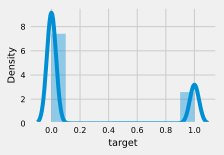

In [19]:
target_name = df['target']
sns.distplot(target_name, bins=10)

##### матрица кореляций признаков<a class='anchor' id='matrix'>

In [20]:
plt.figure(figsize = (80, 80))

sns.set(font_scale=0.5)

corr_matrix=df.corr()
corr_matrix = np.round(corr_matrix, 2)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0

sns.heatmap(corr_matrix, annot=True, linewidths=0.3, cmap='coolwarm', cbar=False, square=True)

plt.title('Correlation matrix')
plt.show()

In [21]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features

,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,D_44,B_4,D_45,B_5,R_2,D_46,D_47,D_48,D_49,B_6,B_7,B_8,D_50,D_51,B_9,R_3,D_52,P_3,B_10,D_53,S_5,B_11,S_6,D_54,R_4,S_7,B_12,S_8,D_55,D_56,B_13,R_5,D_58,S_9,B_14,D_59,D_60,D_61,B_15,S_11,D_62,D_65,B_16,B_17,B_18,B_19,D_66,B_20,D_68,S_12,R_6,S_13,B_21,D_69,B_22,D_70,D_71,D_72,S_15,B_23,D_73,P_4,D_74,D_75,D_76,B_24,R_7,D_77,B_25,B_26,D_78,D_79,R_8,R_9,S_16,D_80,R_10,R_11,B_27,D_81,D_82,S_17,R_12,B_28,R_13,D_83,R_14,R_15,D_84,R_16,B_29,B_30,S_18,D_86,D_87,R_17,R_18,D_88,S_19,R_19,B_32,S_20,R_20,R_21,B_33,D_89,R_22,R_23,D_91,D_92,D_93,D_94,R_24,R_25,D_96,S_22,S_23,S_24,S_25,S_26,D_102,D_103,D_104,D_105,D_106,D_107,B_36,B_37,R_26,R_27,B_38,D_108,D_109,D_110,D_111,B_39,D_112,B_40,S_27,D_113,D_114,D_115,D_116,D_117,D_118,D_119,D_120,D_121,D_122,D_123,D_124,D_125,D_126,D_127,D_128,D_129,B_41,B_42,D_130,D_131,D_132,D_133,R_28,D_134,D_135,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145
0,0.934745,0.009119,0.009382,1.007647,0.006104,0.135021,0.001604,0.007174,0.0,0.000000,0.003258,0.070793,0.740102,0.231717,0.008309,0.420521,0.539715,0.192376,0.000000,0.149564,0.058425,0.002927,0.153461,0.673522,0.009535,0.000085,0.203524,0.629392,0.326101,0.000000,0.034643,0.010260,0.001770,1.008097,0.008517,0.105671,0.112294,0.488232,0.187285,0.166636,0.100107,0.009444,0.007174,0.007397,0.010239,0.063465,0.258461,0.227637,0.014553,0.402246,0.446568,0.008656,0.006408,0.000000,1.007897,0.005274,0.0,0.007630,6.0,0.184036,0.003945,0.686719,0.005375,0.005469,0.008050,0.008254,0.377991,0.006970,0.304625,0.040367,0.0,0.006564,0.001298,0.001352,0.0,0.002230,0.009162,0.421334,0.006475,0.001068,0.000747,0.002193,0.006345,0.0,0.000026,0.208253,0.001057,0.009351,0.007236,0.009177,0.507423,0.006550,1.002178,0.084745,0.006099,0.000013,0.002902,0.001115,0.001911,0.003256,0.0,0.0,0.001277,0.009968,0.0,0.002330,0.002517,0.0,0.003511,0.008099,0.007645,0.009411,0.006355,0.008501,1.007528,0.004638,0.001445,0.003080,1.006011,0.003641,0.004638,0.003866,0.005909,0.005458,0.001190,0.917811,0.131801,0.936067,0.971994,0.001281,0.943340,1.002457,1.014510,1.073985,0.000000,0.671683,0.007441,0.008676,0.0,1.006130,2.0,0.0,0.000226,0.0,0.0,0.0,1.009372,0.100454,0.928955,0.003658,1.0,0.255787,0.0,4.0,0.260255,0.256656,0.0,0.719791,0.433844,0.003580,0.684978,0.008398,1.0,1.008338,0.999737,1.008523,0.003973,0.0,0.004186,0.005702,0.000000,0.006210,0.002715,0.0,0.0,0.0,0.0,0.0,0.007186,0.004234,0.005086,0.000000,0.005810,0.002970,0.008533
1,0.880519,0.178126,0.034684,1.004028,0.006911,0.165509,0.005552,0.005068,0.0,0.060646,0.008781,0.020626,0.266275,0.027000,0.004976,0.438828,0.402195,0.014696,0.000000,0.167634,0.028411,0.000974,0.000000,0.339683,0.012926,0.102036,0.242366,0.570898,0.297130,0.000000,0.043929,0.014570,0.002911,1.002821,0.003283,0.208516,0.019050,0.406434,0.036112,0.748383,0.017684,0.005880,0.009756,0.127805,0.018667,0.212538,0.411989,0.048978,0.009538,0.363754,0.233980,0.008747,0.002940,0.000000,1.003602,0.008047,0.0,0.004319,6.0,0.192371,0.007744,0.287101,0.006190,0.007636,0.006174,0.000883,0.007636,0.001278,0.304711,0.014705,0.0,0.004659,0.007925,0.009600,0.0,0.002383,0.008256,0.227755,0.021153,0.000182,0.001542,0.009117,0.006892,0.0,0.006931,0.002119,0.002046,0.009664,0.005375,0.005009,0.000000,0.005414,1.008568,0.019672,0.006197,0.005370,0.006271,0.009911,0.000983,0.006669,0.0,0.0,0.009298,0.006460,0.0,0.006503,0.007052,0.0,0.005091,0.001838,0.008645,0.009467,0.003500,0.000473,1.000766,0.004864,0.000907,0.003830,0.009166,0.004641,0.000195,0.000523,0.006421,0.004975,0.002397,0.920889,0.132865,0.930629,0.977674,0.003213,0.001621,0.008952,0.004363,0.000000,0.000000,0.007774,0.007457,0.032899,0.0,1.007599,2.0,0.0,0.004743,0.0,0.0,0.0,1.006547,0.019811,0.292214,0.009312,1.0,0.454329,0.0,-1.0,0.446036,0.436884,0.0,0.551341,0.286821,0.008603,0.136650,0.009314,1.0,0.000229,0.999252,0.001777,0.002943,0.0,0.002202,0.001928,0.000000,0.002996,0.001701,0.0,0.0,0.0,0.0,0.0,0.002980,0.007479,0.007870,0.000000,0.003284,0.003169,0

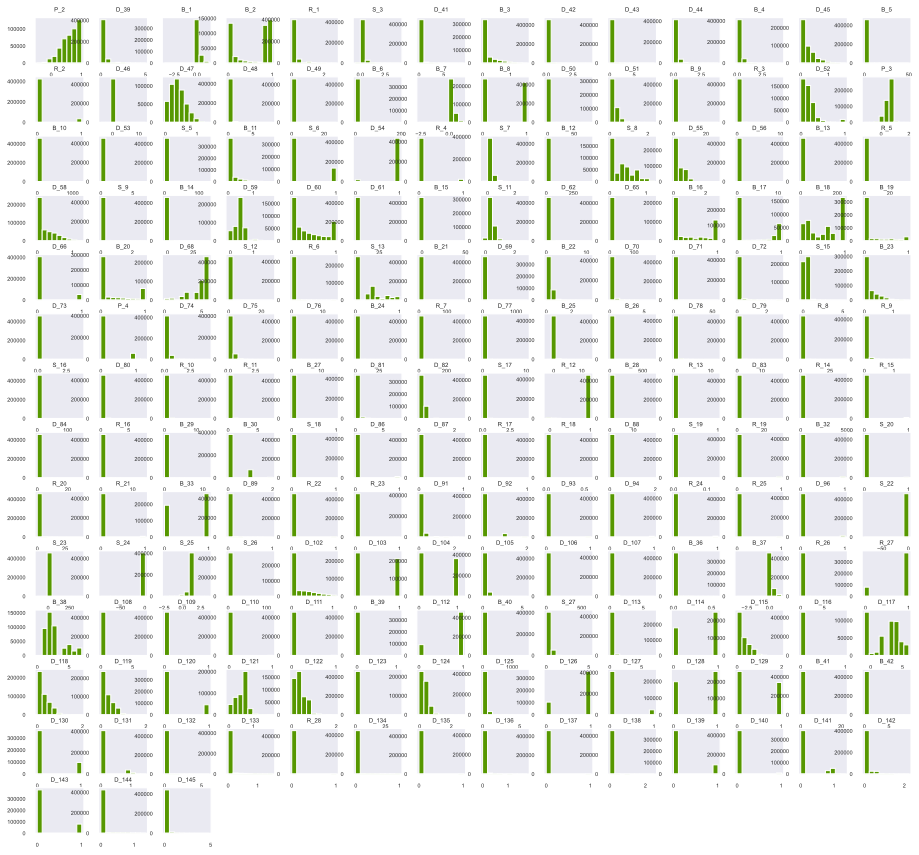

In [22]:
df_num_features.hist(figsize=(14,14), bins=9, color='#569700', grid=False);

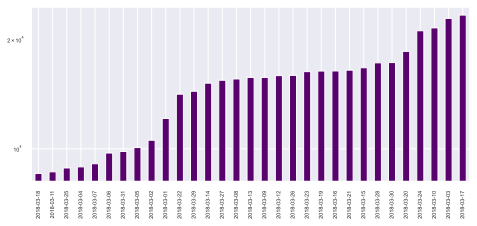

In [23]:
matplotlib.rcParams.update({'font.size': 12})
rcParams['figure.figsize'] = 7, 3

date_info = pd.Series(df['S_2'].value_counts(), index=df['S_2'].unique())
date_info.sort_values().plot(kind="bar", color='#58026D', logy=True)

plt.show()

*Больше всего кредитов было выдано 17, 03, 10 и 24 марта 2018г*

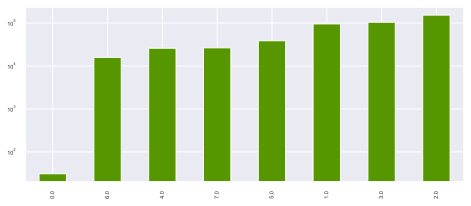

In [24]:
matplotlib.rcParams.update({'font.size': 12})
rcParams['figure.figsize'] = 7, 3

date_info = pd.Series(df['B_38'].value_counts(), index=df['B_38'].unique())
date_info.sort_values().plot(kind="bar", color='#569700', logy=True)

plt.show()

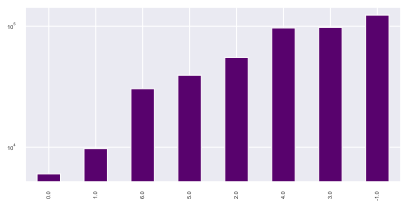

In [25]:
rcParams['figure.figsize'] = 6, 3
matplotlib.rcParams.update({'font.size': 12})
date_info = pd.Series(df['D_117'].value_counts(), index=df['D_117'].unique())
date_info.sort_values().plot(kind="bar", color='#58026D', logy=True)

plt.show()

### 6. Отбор признаков<a class='selection' id='selection'>

* [вернуться в меню](#menu)

In [43]:
df.columns.tolist()

['customer_ID',
 'S_2',
 'P_2',
 'D_39',
 'B_1',
 'B_2',
 'R_1',
 'S_3',
 'D_41',
 'B_3',
 'D_42',
 'D_43',
 'D_44',
 'B_4',
 'D_45',
 'B_5',
 'R_2',
 'D_46',
 'D_47',
 'D_48',
 'D_49',
 'B_6',
 'B_7',
 'B_8',
 'D_50',
 'D_51',
 'B_9',
 'R_3',
 'D_52',
 'P_3',
 'B_10',
 'D_53',
 'S_5',
 'B_11',
 'S_6',
 'D_54',
 'R_4',
 'S_7',
 'B_12',
 'S_8',
 'D_55',
 'D_56',
 'B_13',
 'R_5',
 'D_58',
 'S_9',
 'B_14',
 'D_59',
 'D_60',
 'D_61',
 'B_15',
 'S_11',
 'D_62',
 'D_63',
 'D_64',
 'D_65',
 'B_16',
 'B_17',
 'B_18',
 'B_19',
 'D_66',
 'B_20',
 'D_68',
 'S_12',
 'R_6',
 'S_13',
 'B_21',
 'D_69',
 'B_22',
 'D_70',
 'D_71',
 'D_72',
 'S_15',
 'B_23',
 'D_73',
 'P_4',
 'D_74',
 'D_75',
 'D_76',
 'B_24',
 'R_7',
 'D_77',
 'B_25',
 'B_26',
 'D_78',
 'D_79',
 'R_8',
 'R_9',
 'S_16',
 'D_80',
 'R_10',
 'R_11',
 'B_27',
 'D_81',
 'D_82',
 'S_17',
 'R_12',
 'B_28',
 'R_13',
 'D_83',
 'R_14',
 'R_15',
 'D_84',
 'R_16',
 'B_29',
 'B_30',
 'S_18',
 'D_86',
 'D_87',
 'R_17',
 'R_18',
 'D_88',
 'B_31',
 'S_

In [26]:
features = ['P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_42', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5',
 'R_2', 'D_46', 'D_47', 'D_48', 'D_49', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53',
 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 
'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_63', 'D_64', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'D_66', 'B_20', 'D_68',
 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'D_73', 'P_4', 'D_74', 'D_75', 
'D_76', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'R_9', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27',
 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_29', 'B_30', 'S_18', 'D_86',
 'D_87', 'R_17', 'R_18', 'D_88', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23',
 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103', 'D_104',
 'D_105', 'D_106', 'D_107', 'B_36', 'B_37', 'R_26', 'R_27', 'B_38', 'D_108', 'D_109', 'D_110', 'D_111', 'B_39', 'D_112',
 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_116', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125',
 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'B_42', 'D_130', 'D_131', 'D_132', 'D_133', 'R_28', 'D_134', 'D_135', 'D_136',
 'D_137', 'D_138', 'D_139', 'D_140', 'D_141', 'D_142', 'D_143', 'D_144', 'D_145']

new_feature_names = ['D_64_cat', 'D_S_cat', 'D_B_cat', 'D_B_cat_2']

target = 'target'

### 7. Разбиение на train и test<a class='splitting' id='splitting'>

* [вернуться в меню](#menu)

In [27]:
X = df.drop(columns=target)
y = df[target]

In [28]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.33, shuffle=True, random_state=21)
X_train.shape, X_valid.shape

((307471, 195), (151442, 195))

In [29]:
X_train.isna().sum().sum(), X_valid.isna().sum().sum()

(0, 0)

In [30]:
del df

### 8. Построение модели<a class='model' id='model'>

* [вернуться в меню](#menu)

In [31]:
#соберем наш простой pipeline, но нам понадобится написать класс для выбора нужного поля
class FeatureSelector(BaseEstimator, TransformerMixin):
    def __init__(self, column):
        self.column = column

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        return X[self.column]
    
class NumberSelector(BaseEstimator, TransformerMixin):
    """
    Transformer to select a single column from the data frame to perform additional transformations on
    Use on numeric columns in the data
    """
    def __init__(self, key):
        self.key = key

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return X[[self.key]]
    
class OHEEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, key):
        self.key = key
        self.columns = []

    def fit(self, X, y=None):
        self.columns = [col for col in pd.get_dummies(X, prefix=self.key).columns]
        return self

    def transform(self, X):
        X = pd.get_dummies(X, prefix=self.key)
        test_columns = [col for col in X.columns]
        for col_ in self.columns:
            if col_ not in test_columns:
                X[col_] = 0
        return X[self.columns]
    

categorical_columns = ['B_30', 'B_38', 'D_114', 'D_116', 'D_117', 'D_120', 'D_126', 'D_63_cat', 'D_64_cat', 'D_66', 'D_68']
continuous_columns = ['P_2','D_39','B_1','B_2','R_1','S_3','D_41','B_3','D_42','D_43','D_44','B_4','D_45','B_5','R_2','D_46','D_47',
 'D_48','D_49','B_6','B_7','B_8','D_50','D_51','B_9','R_3','D_52','P_3','B_10','D_53','S_5','B_11','S_6','D_54','R_4','S_7','B_12','S_8', 
'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20',
 'S_12','R_6','S_13','B_21','D_69','B_22','D_70','D_71','D_72','S_15','B_23','D_73','P_4','D_74','D_75','D_76','B_24','R_7','D_77','B_25',
 'B_26','D_78','D_79','R_8','R_9','S_16','D_80','R_10','R_11','B_27','D_81','D_82','S_17','R_12','B_28','R_13','D_83','R_14','R_15','D_84','R_16','B_29','S_18',
 'D_86','D_87','R_17','R_18','D_88','B_31','S_19','R_19','B_32','S_20','R_20','R_21','B_33','D_89','R_22','R_23','D_91','D_92','D_93','D_94','R_24','R_25','D_96',
 'S_22','S_23','S_24','S_25','S_26','D_102','D_103','D_104','D_105','D_106','D_107','B_36','B_37','R_26','R_27', 'D_108','D_109','D_110','D_111','B_39',
 'D_112','B_40','S_27','D_113', 'D_115','D_118','D_119','D_121','D_122','D_123','D_124','D_125','D_127','D_128','D_129','B_41',
 'B_42','D_130','D_131','D_132','D_133','R_28','D_134','D_135','D_136','D_137','D_138','D_139','D_140','D_141','D_142','D_143',
 'D_144','D_145']

# все категорийные признаки
# customer_ID	S_2	D_63	D_64	B_31	target + новые признаки
# убрала колонки, используемы в нов.признаках
# ['B_30', 'B_38', 'D_114', 'D_116', 'D_117', 'D_120', 'D_126', 'D_63', 'D_64', 'D_66', 'D_68']


final_transformers = list()
    
for cont_col in continuous_columns:
    cont_transformer = Pipeline([
                ('selector', NumberSelector(key=cont_col)),
                ('scaler', StandardScaler())
            ])
    final_transformers.append((cont_col, cont_transformer))

for cat_col in categorical_columns:
    cat_transformer = Pipeline([
                ('selector', FeatureSelector(column=cat_col)),
                ('ohe', OHEEncoder(key=cat_col))
            ])
    final_transformers.append((cat_col, cat_transformer))
    
    
feats = FeatureUnion(final_transformers)

feature_processing = Pipeline([('feats', feats)])

### 9. Обучение моделей классификации<a class='model' id='lern'>

* [вернуться в меню](#menu)

#### 1. Логистическая регрессия

In [55]:
from sklearn.linear_model import LogisticRegression

In [56]:
log = Pipeline([
    ('features',feats),
    ('classifier', LogisticRegression(random_state = 42)),
])


In [57]:
%%time
#обучим наш пайплайн
log.fit(X_train, y_train)

Wall time: 15 s


Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('P_2',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='P_2')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('D_39',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='D_39')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('B_1',
                                                 Pipeline(steps=[('selector',
                                                   

Посчитаем коэффициент детерминации (R2)

In [58]:
predictions = log.predict(X_valid)
score_n = r2_score(y_pred=predictions, y_true=y_valid)

In [59]:
score_n

0.46785098021756544

In [60]:
from sklearn.metrics import precision_recall_curve
precision, recall, thresholds = precision_recall_curve(y_valid, predictions)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score_1 = r2_score(y_pred=predictions, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score_1))

Best Threshold=1.000000, F-Score=0.798, Precision=0.818, Recall=0.779, r2_score=0.468


In [61]:
# запишу данные
l = []
l.append('LogisticRegression')
l.append(format(thresholds[ix], '.3f')), l.append(format(fscore[ix], '.3f')),  
l.append(format(precision[ix], '.3f')), l.append(format(recall[ix], '.3f')), l.append(format(score_1, '.3f'))
l

['LogisticRegression', '1.000', '0.798', '0.818', '0.779', '0.468']

#### 2. LinearRegression

* [вернуться в меню](#menu)

In [32]:
reg = Pipeline([
    ('features',feats),
    ('classifier', LinearRegression()),
])


In [33]:
%%time
#обучим наш пайплайн
reg.fit(X_train, y_train)

Wall time: 9.7 s


Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('P_2',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='P_2')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('D_39',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='D_39')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('B_1',
                                                 Pipeline(steps=[('selector',
                                                   

In [34]:
# Посчитаем коэффициент детерминации (R2)

predictions2 = reg.predict(X_valid)
score_n_2 = r2_score(y_pred=predictions2, y_true=y_valid)
score_n_2

0.5826856303102678

In [35]:
from sklearn.metrics import precision_recall_curve
precision, recall, thresholds = precision_recall_curve(y_valid, predictions2)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score_1 = r2_score(y_pred=predictions2, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score_1))

Best Threshold=0.398315, F-Score=0.804, Precision=0.754, Recall=0.860, r2_score=0.583


In [66]:
# запишу данные
l2 = []
l2.append('LinearRegression')
l2.append(format(thresholds[ix], '.3f')), l2.append(format(fscore[ix], '.3f')),  
l2.append(format(precision[ix], '.3f')), l2.append(format(recall[ix], '.3f')), l2.append(format(score_1, '.3f'))
l2

['LinearRegression', '0.398', '0.804', '0.754', '0.860', '0.583']

#### 3. модель xgbboost

* [вернуться в меню](#menu)

In [67]:
%%time
import xgboost as xgb
model = Pipeline([
    ('features',feats),
    ('classifier', xgb.XGBRFClassifier()),
])

#обучим наш пайплайн
model.fit(X_train, y_train)

[15:43:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.0/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Wall time: 1min 25s


Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('P_2',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='P_2')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('D_39',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='D_39')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('B_1',
                                                 Pipeline(steps=[('selector',
                                                   

In [68]:
predict_xgb = model.predict(X_valid)
precision, recall, thresholds = precision_recall_curve(y_valid, predict_xgb)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score_2 = r2_score(y_pred=predict_xgb, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score_2))

Best Threshold=1.000000, F-Score=0.771, Precision=0.779, Recall=0.763, r2_score=0.388


In [69]:
l3=[]
l3.append('XGBRFClassifie')
l3.append(format(thresholds[ix], '.3f')), l3.append(format(fscore[ix], '.3f')),  
l3.append(format(precision[ix], '.3f')), l3.append(format(recall[ix], '.3f')), l3.append(format(score_2, '.3f'))

(None, None, None)

In [70]:
l3

['XGBRFClassifie', '1.000', '0.771', '0.779', '0.763', '0.388']

#### 4. RandomForestClassifier


* [вернуться в меню](#menu)

In [71]:
from sklearn.ensemble import RandomForestClassifier
forest_model = Pipeline([
    ('features',feats),
    ('classifier', RandomForestClassifier(random_state = 42,)), #class_weight={0:1,1:4} причину выноса описала под метрикой
])

Обучим модель

In [72]:
%%time
#обучим наш пайплайн
model_forest = forest_model.fit(X_train, y_train)

Wall time: 12min 8s


In [73]:
from sklearn.metrics import precision_recall_curve
predict_rend_forest = model_forest.predict(X_valid)
precision, recall, thresholds = precision_recall_curve(y_valid, predict_rend_forest)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score_3 = r2_score(y_pred=predict_rend_forest, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score_3))

Best Threshold=1.000000, F-Score=0.797, Precision=0.806, Recall=0.788, r2_score=0.457


In [74]:
# Best Threshold=1.000000, F-Score=0.773, Precision=0.788, Recall=0.759, r2_score=0.398 - без параметров
# Best Threshold=1.000000, F-Score=0.626, Precision=0.840, Recall=0.499, r2_score=0.194 - n_estimators=100,
#           max_depth= 3, min_samples_leaf = 2
# Best Threshold=1.000000, F-Score=0.706, Precision=0.805, Recall=0.629, r2_score=0.294 - n_estimators=1000, max_depth= 5, min_samples_leaf = 4
# Best Threshold=1.000000, F-Score=0.459, Precision=0.896, Recall=0.308, r2_score=0.018 - n_estimators=100, max_depth= 2, min_samples_leaf = 7

# Best Threshold=1.000000, F-Score=0.771, Precision=0.784, Recall=0.759, r2_score=0.393 - min_samples_leaf = 7
# Best Threshold=1.000000, F-Score=0.769, Precision=0.784, Recall=0.755, r2_score=0.388 - min_samples_leaf = 11

In [75]:
l4=[]
l4.append('RandomForestClassifier')
l4.append(format(thresholds[ix], '.3f')), l4.append(format(fscore[ix], '.3f')),  
l4.append(format(precision[ix], '.3f')), l4.append(format(recall[ix], '.3f')), l4.append(format(score_3, '.3f'))
l4

['RandomForestClassifier', '1.000', '0.797', '0.806', '0.788', '0.457']

#### 5. ExtraTreesClassifier

* [вернуться в меню](#menu)

In [76]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.datasets import make_classification

In [77]:
%%time
pipeline = Pipeline([
    ('features',feats),
    ('classifier', ExtraTreesClassifier(n_estimators=100, random_state=0)),
])

#обучим наш пайплайн
pipeline.fit(X_train, y_train)



Wall time: 3min


Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('P_2',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='P_2')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('D_39',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='D_39')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('B_1',
                                                 Pipeline(steps=[('selector',
                                                   

In [78]:
predict_extra_tree = pipeline.predict(X_valid)
precision, recall, thresholds = precision_recall_curve(y_valid, predict_extra_tree)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score_5 = r2_score(y_pred=predict_extra_tree, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score_5))

Best Threshold=1.000000, F-Score=0.791, Precision=0.805, Recall=0.777, r2_score=0.445


In [79]:
l5=[]
l5.append('ExtraTreesClassifier')
l5.append(format(thresholds[ix], '.3f')), l5.append(format(fscore[ix], '.3f')),  
l5.append(format(precision[ix], '.3f')), l5.append(format(recall[ix], '.3f')), l5.append(format(score_5, '.3f'))

(None, None, None)

#### 6. GradientBoostingClassifier

* [вернуться в меню](#menu)

In [80]:
from sklearn.ensemble import GradientBoostingClassifier

pipeline = Pipeline([
    ('features',feats),
    ('classifier', GradientBoostingClassifier(random_state = 42)),
])

In [81]:
%%time
#обучим наш пайплайн
pipeline.fit(X_train, y_train)

Wall time: 42min 30s


Pipeline(steps=[('features',
                 FeatureUnion(transformer_list=[('P_2',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='P_2')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('D_39',
                                                 Pipeline(steps=[('selector',
                                                                  NumberSelector(key='D_39')),
                                                                 ('scaler',
                                                                  StandardScaler())])),
                                                ('B_1',
                                                 Pipeline(steps=[('selector',
                                                   

In [82]:
#наши прогнозы для тестовой выборки
preds_gb = pipeline.predict(X_valid)
precision, recall, thresholds = precision_recall_curve(y_valid, preds_gb)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score_6 = r2_score(y_pred=preds_gb, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score_6))

Best Threshold=1.000000, F-Score=0.800, Precision=0.800, Recall=0.799, r2_score=0.459


In [83]:
l6=[]
l6.append('GradientBoostingClassifier')
l6.append(format(thresholds[ix], '.3f')), l6.append(format(fscore[ix], '.3f')),  
l6.append(format(precision[ix], '.3f')), l6.append(format(recall[ix], '.3f')), l6.append(format(score_6, '.3f'))

(None, None, None)

### 10. Отбор лучшей модели. Выводы<a id='best'>

* [обратно к меню](#menu)

In [84]:
my_list = list()
my_list.append(l), my_list.append(l2), my_list.append(l3), my_list.append(l4), my_list.append(l5), my_list.append(l6)
my_list = pd.DataFrame(my_list, columns=['Model','Threshold', 'F-Score', 'Precision', 'Recall', 'r2_score'])
my_list.sort_values('F-Score', ascending=False)

,Model,Threshold,F-Score,Precision,Recall,r2_score
1,LinearRegression,0.398,0.804,0.754,0.860,0.583
5,GradientBoostingClassifier,1.000,0.800,0.800,0.799,0.459
0,LogisticRegression,1.000,0.798,0.818,0.779,0.468
3,RandomForestClassifier,1.000,0.797,0.806,0.788,0.457
4,ExtraTreesClassifier,1.000,0.791,0.805,0.777,0.445
2,XGBRFClassifie,1.000,0.771,0.779,0.763,0.388


*По F-Score лучше всего показала себя модель LinearRegression с лучшей полнотой(Recall). Считаю, что смотреть нужно на метрику F-Score, т.к. она учитывает и точность и полноту, поэтому она объективнее оценивает качество модели. Модель GradientBoostingClassifier также показала хорошие результаты, но обучается такая модель занчитель дольше остальных. На тестовых данных используем LinearRegression.*

### 11. Подбор гиперпараметров<a id='best_2'>

* [обратно к меню](#menu)

In [128]:
params = {'classifier__normalize': [True, False],
         'classifier__positive':[True, False]}

In [129]:
%%time
from sklearn.model_selection import GridSearchCV
grid = GridSearchCV(reg,
                    param_grid=params,
                    n_jobs=-1)


Wall time: 141 ms


In [104]:
LinearRegression().get_params()

{'copy_X': True,
 'fit_intercept': True,
 'n_jobs': None,
 'normalize': 'deprecated',
 'positive': False}

In [131]:
%%time
search = grid.fit(X_train, y_train)

Wall time: 9min 10s


In [132]:
search.best_score_

0.5769764848209917

In [133]:
search.best_params_

{'classifier__normalize': False, 'classifier__positive': False}

In [36]:
pipeline_best = Pipeline([
    ('features',feats),
    ('classifier', LinearRegression(normalize= False,
                                    positive= False,
                                      n_jobs=-1)),
])

In [137]:
%%time
from sklearn.model_selection import cross_val_score
#запустим кросс-валидацию
cv_scores = cross_val_score(pipeline_best, X_train, y_train, scoring='roc_auc', cv=5)
cv_score = np.mean(cv_scores)
cv_score_std = np.std(cv_scores)
print(f'CV score is {cv_score} +- {cv_score_std}')

CV score is 0.9531671679826819 +- 0.001013379487818653
Wall time: 41.1 s


In [37]:
%%time
# обучим пайплайн на всем тренировочном датасете
pipeline_best.fit(X_train, y_train)
y_score7=pipeline_best.predict(X_valid)

Wall time: 9.53 s


*Разброс небольшой, значит все модели сошлись более менее в одну точку. Это означает, что модель устойчивая.*

### 12. Бизнес метрики<a id='busines'>

* [обратно к меню](#menu)

In [38]:
precision, recall, thresholds = precision_recall_curve(y_valid, y_score7)

fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
score = r2_score(y_pred=y_score7, y_true=y_valid)
print('Best Threshold=%f, F-Score=%.3f, Precision=%.3f, Recall=%.3f, r2_score=%.3f' % (thresholds[ix], 
                                                                        fscore[ix],
                                                                        precision[ix],
                                                                        recall[ix],
                                                                        score))

Best Threshold=0.398315, F-Score=0.804, Precision=0.754, Recall=0.860, r2_score=0.583


In [39]:
l7 = []
l7.append('LinearRegression_best')
l7.append(format(thresholds[ix], '.3f')), l7.append(format(fscore[ix], '.3f')),  
l7.append(format(precision[ix], '.3f')), l7.append(format(recall[ix], '.3f')), l7.append(format(score, '.3f'))

(None, None, None)

In [143]:
l2,l7

(['LinearRegression', '0.398', '0.804', '0.754', '0.860', '0.583'],
 ['LinearRegression_best', '0.398', '0.804', '0.754', '0.860', '0.583'])

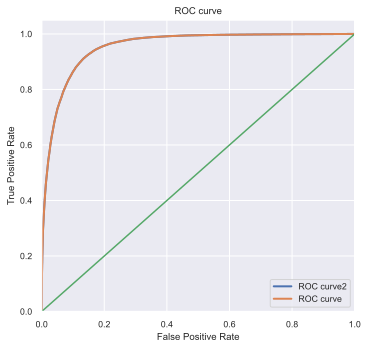

In [40]:
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.style.use('fivethirtyeight')
matplotlib.rcParams.update({'font.size': 4})
import seaborn as sns
from sklearn.metrics import precision_recall_curve, roc_curve, roc_auc_score

sns.set(font_scale=0.8)
sns.set_color_codes("muted")

plt.figure(figsize=(5, 5))
fpr1, tpr1, thresholds_ = roc_curve(y_valid, predictions2, pos_label=1)# C = 1
fpr2, tpr2, thresholds_ = roc_curve(y_valid, y_score7, pos_label=1)#C = 0,6
lw = 2

plt.plot(fpr2, tpr2, lw=lw, label='ROC curve2')
plt.plot(fpr1, tpr1, lw=lw, label='ROC curve')
plt.plot([0, 1], [0, 1])
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend()
plt.savefig("ROC.png")
plt.show()

In [41]:
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Посомтрим на матрицу ошибок

Confusion matrix, without normalization
[[101146  11005]
 [  5488  33803]]


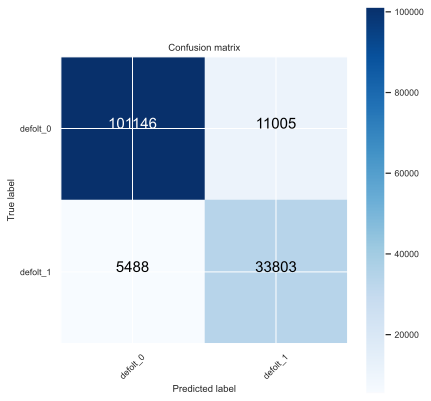

In [42]:
from sklearn.metrics import confusion_matrix
#мы уже нашли ранее "оптимальный" порог, когда максимизировали f_score
font = {'size' : 15}

plt.rc('font', **font)

business_threshold = 1  # подберем порог для улучшения бизнесс показателя

cnf_matrix = confusion_matrix(y_valid, y_score7>thresholds[ix]*business_threshold)
plt.figure(figsize=(6, 6))
plot_confusion_matrix(cnf_matrix, classes=['defolt_0', 'defolt_1'],
                      title='Confusion matrix')
plt.savefig("conf_matrix.png")
plt.show()

Посчитаем FPR, TPR

In [185]:
TN = cnf_matrix[0][0]
FN = cnf_matrix[1][0]
TP = cnf_matrix[1][1]
FP = cnf_matrix[0][1]

TPR = TP/(TP+FN)
FPR = FP/(FP+TN)
TNR = TN/(FP+TN)
TPR, FPR, TNR

(0.8603242472830929, 0.0981266328432203, 0.9018733671567797)

False Positive Rate довольно низкий ~ 0.09.

Это означает, что 9 процентов всех заемщиков получат метку 1 при том, что они на самом деле вернут кредит.

#### Допустим:

 - средний расход банка 15000 от клиента, который, предположительно, выйдет в просрочку более 120 дней и банк начал работу по возврату кредита.
 - средний расход банка 25000 от клиента, которого не угадали и он вышел в просрочку более 120 дней
 - расход банка на дополнительную рабочую единицу 1400
 
 
 - не верно угаданные, погасили кредит FP = cnf_matrix[0][1]
 - пропустили в будущем дефолтных заемщиков FN = cnf_matrix[1][0]
 - правильно определили будущих заемщиков TP = cnf_matrix[1][1]

Оценим расходы, если ждать когда заемщик выйдет в просрочку более 120 дней:

In [153]:
rubl_to_men = 1400
rubl_to_early_defolt = 15000
rubl_to_late_defolt = 25000

In [154]:
rubl_1 = (cnf_matrix[1][0]+cnf_matrix[1][1]) * rubl_to_late_defolt
print('расходы, если не работать с должником и ждать когда выйдет на просрочку более 120 дней:',rubl_1)

расходы, если не работать с должником и ждать когда выйдет на просрочку более 120 дней: 982275000


Расходы, если работать с каждым заемщик и не ждать 120 дней просрочки:


In [155]:
rubl_all_defolt = np.sum(cnf_matrix) * rubl_to_men + (cnf_matrix[1][0]+cnf_matrix[1][1]) * rubl_to_early_defolt
print('расходы, если добавить ставку и работать с каждым заемщиком и не ждать 120 дней просрочки:',rubl_all_defolt)

расходы, если добавить ставку и работать с каждым заемщиком и не ждать 120 дней просрочки: 801383800


In [156]:
TN = cnf_matrix[0][0]
FN = cnf_matrix[1][0]
TP = cnf_matrix[1][1]
FP = cnf_matrix[0][1]

TPR = TP/(TP+FN)
FPR = FP/(FP+TN)
TNR = TN/(FP+TN)
TPR, FPR, TNR

(0.8603242472830929, 0.0981266328432203, 0.9018733671567797)

Расходы если использовать ML:

In [157]:
rubl_ML = (cnf_matrix[0][1]+cnf_matrix[1][1]) * rubl_to_men + (cnf_matrix[1][0]) * rubl_to_late_defolt + np.sum(cnf_matrix[1][1]) * rubl_to_early_defolt
print('расходы, если добавить вакантную ставку и работать с предугаданными дефолтниками:',rubl_ML)

# (FP + TP) + (FN *  + sum(TP)) 

расходы, если добавить вакантную ставку и работать с предугаданными дефолтниками: 706976200


Оценим разницу:


In [158]:
print('Расходы при решении не добавлять вакантную ставку и ждать дефолта клиента - расходы с МL:',rubl_1 - rubl_ML )
print('Расходы при решении не добавлять вакантную ставку и ждать дефолт - расходы если добавить ставку и работать с каждым:',rubl_1 - rubl_all_defolt )
print('Расходы добавить вакантную ставку и работать со всеми - решение работать с предсказанными ML:',rubl_all_defolt - rubl_ML )

Расходы при решении не добавлять вакантную ставку и ждать дефолта клиента - расходы с МL: 275298800
Расходы при решении не добавлять вакантную ставку и ждать дефолт - расходы если добавить ставку и работать с каждым: 180891200
Расходы добавить вакантную ставку и работать со всеми - решение работать с предсказанными ML: 94407600


Банк понесёт гораздо меньше убытков, если будет использовать ML модель.

In [159]:
def business_threshold_calibrate(y_test, y_score, thresholds,rubl_to_men = 100, rubl_to_early_defolt = 100, rubl_to_late_defolt = 1000):
    business_threshold = 0
    r1_r2_ = 0
    r1_r3_ = 0
    r2_r3_ = 0
    rubl_1_ = - 10000000 
    rubl_all_test_ = - 10000000 
    rubl_ML_ = - 10000000 

    r2 = []
    n = 20
    for opt_buisness_tr in np.linspace(0,1,n).tolist():
        # подберем порог для улучшения бизнесс показателя

        cnf_matrix = confusion_matrix(y_test, y_score > ( opt_buisness_tr))
        #print(cnf_matrix )
        rubl_1 = ((cnf_matrix[1][1]+cnf_matrix[1][0])) * rubl_to_late_defolt

        rubl_all_defolt = np.sum(cnf_matrix) * rubl_to_men + ((cnf_matrix[1][0]+cnf_matrix[1][1])) * rubl_to_early_defolt

        rubl_ML = ((cnf_matrix[1][1]+cnf_matrix[0][1])) * rubl_to_men + np.sum(cnf_matrix[1][0]) * rubl_to_late_defolt + (cnf_matrix[1][1]) * rubl_to_early_defolt
       
        r2_r3 = rubl_all_defolt - rubl_ML 
        
        r1_r2 = rubl_1 - rubl_all_defolt
        r1_r3 = rubl_1 - rubl_ML
        #print(opt_buisness_tr, r2_r3)
        if (r2_r3_ < r2_r3):
            
            business_threshold = opt_buisness_tr
            r1_r2_ = r1_r2
            r1_r3_ = r1_r3
            r2_r3_ = r2_r3
            rubl_1_ = rubl_1
            rubl_all_defolt_ = rubl_all_defolt
            rubl_ML_ = rubl_ML
            
        r2.append(r2_r3)   
            
    
    print('расходы, если не работать с должником и ждать когда будет дефолт:',rubl_1_)
    print('расходы, если добавить ставку и работать с каждым заемщиком не ждать дефолт:',rubl_all_defolt_)
    print('расходы, если добавить вакантную ставку и работать с предугаданными ML дефолтниками:',rubl_ML_)
    print('Расходы при решении не добавлять вакантную ставку и ждать дефолта - расходы с МL:',r1_r3_ )
    print('Расходы при решении не добавлять вакантную ставку и ждать дефолт - расходы если добавить ставку и работать с каждым:',r1_r2_ )
    print('Расходы добавить вакантную ставку и работать со всеми - решение работать с предсказанными ML:',r2_r3_ )
    plt.plot(np.linspace(0,1,n),r2)
    plt.show()
    return business_threshold
    

расходы, если не работать с должником и ждать когда будет дефолт: 982275000
расходы, если добавить ставку и работать с каждым заемщиком не ждать дефолт: 801383800
расходы, если добавить вакантную ставку и работать с предугаданными ML дефолтниками: 690325200
Расходы при решении не добавлять вакантную ставку и ждать дефолта - расходы с МL: 291949800
Расходы при решении не добавлять вакантную ставку и ждать дефолт - расходы если добавить ставку и работать с каждым: 180891200
Расходы добавить вакантную ставку и работать со всеми - решение работать с предсказанными ML: 111058600


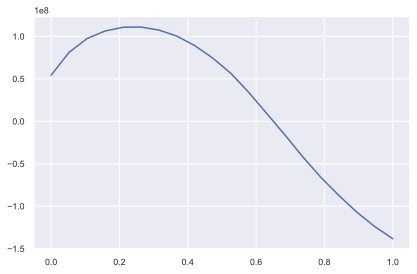

уровень порога по бизнес метрике 0.2631578947368421
уровень порога по f1 метрике 0.3983154296875


In [161]:
BUisnes_tr = business_threshold_calibrate(y_valid, y_score7, 
                                          thresholds[ix] ,
                                          rubl_to_men = 1400, 
                                          rubl_to_early_defolt = 15000, 
                                          rubl_to_late_defolt = 25000)
print('уровень порога по бизнес метрике',BUisnes_tr)
print('уровень порога по f1 метрике',thresholds[ix])

### 13. Прогнозирование на тестовом датасете<a class='test' id='test'>

* [обратно к меню](#menu)

In [43]:
test_df = pd.read_csv(TEST_DATASET_PATH)
test_df.shape

(11363762, 190)

In [44]:
test_df.drop_duplicates(subset=['customer_ID'], keep='last', inplace=True)
test_df.shape

(924621, 190)

In [50]:
preprocessor = DataPreprocessing()
preprocessor.fit(X_train)

test_df = preprocessor.transform(test_df)

test_df.shape

(924621, 194)

In [51]:
features_gen = FeatureGenetator()
features_gen.fit(X_train, y_train)

test_df = features_gen.transform(test_df)

test_df.shape

(924621, 195)

In [48]:
test_df.head(3)

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,D_44,B_4,D_45,B_5,R_2,D_46,D_47,D_48,D_49,B_6,B_7,B_8,D_50,D_51,B_9,R_3,D_52,P_3,B_10,D_53,S_5,B_11,S_6,D_54,R_4,S_7,B_12,S_8,D_55,D_56,B_13,R_5,D_58,S_9,B_14,D_59,D_60,D_61,B_15,S_11,D_62,D_63,D_64,D_65,B_16,B_17,B_18,B_19,D_66,B_20,D_68,S_12,R_6,S_13,B_21,D_69,B_22,D_70,D_71,D_72,S_15,B_23,D_73,P_4,D_74,D_75,D_76,B_24,R_7,D_77,B_25,B_26,D_78,D_79,R_8,R_9,S_16,D_80,R_10,R_11,B_27,D_81,D_82,S_17,R_12,B_28,R_13,D_83,R_14,R_15,D_84,R_16,B_29,B_30,S_18,D_86,D_87,R_17,R_18,D_88,B_31,S_19,R_19,B_32,S_20,R_20,R_21,B_33,D_89,R_22,R_23,D_91,D_92,D_93,D_94,R_24,R_25,D_96,S_22,S_23,S_24,S_25,S_26,D_102,D_103,D_104,D_105,D_106,D_107,B_36,B_37,R_26,R_27,B_38,D_108,D_109,D_110,D_111,B_39,D_112,B_40,S_27,D_113,D_114,D_115,D_116,D_117,D_118,D_119,D_120,D_121,D_122,D_123,D_124,D_125,D_126,D_127,D_128,D_129,B_41,B_42,D_130,D_131,D_132,D_133,R_28,D_134,D_135,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,D_64_cat,D_S_cat,D_B_cat,D_B_cat_2
8,00000469ba478561f23a92a868bd366de6f6527a684c9a...,2019-10-12,0.568930,0.121385,0.010779,1.009347,0.006923,0.149413,0.000396,0.003576,0.103745,0.007398,0.006787,0.124780,0.025111,0.050187,0.007511,0.445881,0.489448,0.517214,0.0,0.024945,0.163441,1.008730,0.0,0.333484,0.005263,0.109464,0.115930,0.560515,0.033599,0.0,0.011795,0.005188,0.003473,1.007686,0.005607,0.159703,0.058696,0.464023,0.458377,0.000000,0.063506,0.005444,0.381320,0.016998,0.008621,0.424651,0.013835,0.589184,0.014091,1.767255,0.049326,CR,U,0.001363,0.002311,0.0,0.590569,0.003994,0.0,0.004525,6.0,0.187650,0.002591,0.555903,0.006617,0.008136,0.007281,0.006583,0.281546,0.008804,0.300419,0.147274,0.178798,0.964865,0.216591,0.202170,0.0,0.007062,0.005943,0.000000,0.005402,0.009328,0.001973,0.008972,0.008869,0.0,0.009269,0.006064,0.007288,0.003654,0.000554,0.000375,0.502701,0.007410,1.006677,0.140051,0.007856,0.007447,0.006869,0.001841,0.003837,0.000871,0.00272,0.0,0.009057,0.009205,0.0,0.005639,0.005024,0.0,1,0.003337,0.004120,0.007153,0.005336,0.004212,0.007244,1.007520,0.008678,0.000612,0.003235,0.003137,1.006260,0.005644,0.000724,0.008165,0.005954,0.004624,0.980107,0.135788,0.957597,0.970630,0.080587,0.003999,0.003953,0.006018,0.000000,0.0,0.000153,0.001118,0.007948,0.0,1.002286,2.0,0.0,0.000151,0.0,0.0,0.0,1.007009,0.375581,0.346436,0.009603,0.0,0.251319,0.0,-1.0,0.247260,0.253784,1.0,0.199254,0.144025,0.004272,0.009896,0.000478,0.0,0.009689,0.001736,0.009961,0.006789,0.0,0.004902,0.000975,0.0,0.006273,0.008816,0.0,0.0,0.0,0.0,0.0,0.005912,0.001250,0.006543,0.000000,0.009160,0.003690,0.003219,2,2,1,3
21,00001bf2e77ff879fab36aa4fac689b9ba411dae63ae39...,2019-04-15,0.841177,0.126475,0.016562,1.009245,0.009715,0.112195,0.006192,0.011386,0.000000,0.000000,0.004234,0.014831,0.099732,0.135907,0.002269,0.445957,0.362383,0.041712,0.0,0.182720,0.014466,1.008640,0.0,0.001505,0.017454,0.008152,0.143998,0.525659,0.298735,0.0,0.009336,0.002235,0.005253,1.003089,0.008385,0.081717,0.054184,0.768435,0.053444,0.063766,0.058585,0.004132,0.006375,0.018508,0.010847,0.608682,0.685577,0.046726,0.005461,0.128330,0.330806,CO,O,0.000348,0.091107,0.0,1.005304,0.003039,0.0,0.000821,6.0,0.190710,0.009712,0.283946,0.004334,0.001395,0.001878,0.003787,0.010397,0.007238,0.107488,0.004756,0.000000,0.005312,0.001835,0.004973,0.0,0.008168,0.006781,0.302335,0.026572,0.005945,0.004499,0.003978,0.001244,0.0,0.005311,0.001574,0.005655,0.000168,0.000172,0.005023,0.000000,0.002403,1.003721,0.008613,0.005523,0.007568,0.005801,0.004484,0.005302,0.002537,0.00000,0.0,0.009161,0.004240,0.0,0.003904,0.007188,0.0,1,0.008257,0.004913,0.007181,0.002152,0.002084,0.002205,1.005250,0.007064,0.001214,0.006069,0.005062,0.006800,0.004039,0.001636,0.005406,0.000981,0.009926,0.928590,0.135659,0.939332,0.974450,0.020564,0.007385,0.006146,0.004748,0.000000,0.0,0.002687,0.007424,0.012894,0.0,1.000501,2.0,0.0,0.006356,0.0,0.0,0.0,1.003549,0.005498,0.590974,0.000565,1.0,0.317455,0.0,3.0,0.316734,0.318151,0.0,0.854850,0.578802,0.00041

In [52]:
%%time
predicts = pipeline_best.predict(test_df)
predicts

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [ ]:
sub = pd.read_csv(PREPARED_TRAIN_DATASET_PATH)
sub.shape

In [ ]:
sub['prediction'] = predicts
sub.head()

In [ ]:
sub.to_csv('sample_submission.csv', index=False)